In [1]:
from __future__ import annotations

%load_ext autoreload
%autoreload 2
%load_ext snakeviz
import logging
import os
import pathlib

import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import xarray as xr
from kneebow.rotor import Rotor
from polartoolkit import maps
from polartoolkit import utils as polar_utils

import RIS_gravity_inversion.plotting as RIS_plotting
import RIS_gravity_inversion.synthetic as RIS_synth
from RIS_gravity_inversion import gravity_processing, ice_shelf_stats

os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

logging.getLogger().setLevel(logging.INFO)

from invert4geom import utils

In [2]:
# set grid parameters
spacing = 2e3
inversion_region = (-40e3, 110e3, -1600e3, -1400e3)

plot_region = inversion_region  # vd.pad_region(inversion_region, -3*spacing)

true_density_contrast = 1476

bathymetry, _, _ = RIS_synth.load_synthetic_model(
    spacing=spacing,
    inversion_region=inversion_region,
    buffer=spacing * 10,
    zref=0,
    bathymetry_density_contrast=true_density_contrast,
    plot_topography=False,
    plot_gravity=False,
)

buffer_region = polar_utils.get_grid_info(bathymetry)[1]

# clip to inversion region
bathymetry = bathymetry.sel(
    easting=slice(plot_region[0], plot_region[1]),
    northing=slice(plot_region[2], plot_region[3]),
)

INFO:polartoolkit:converting to be reference to the WGS84 ellipsoid
INFO:polartoolkit:spacing larger than original, filtering and resampling
grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


  0%|          | 0/7676 [00:00<?, ?it/s]

In [3]:
# get list of all Antarctic ice shelves
ice_shelves = ice_shelf_stats.get_ice_shelves()

# get gravity and constraint spacing stats on ice shelves
ice_shelf_stats_gdf = pd.read_csv(
    "../../data/bedmachine_constraints/ice_shelf_gravity_stats.csv", index_col=None
)

# rescale to be in km
ice_shelf_stats_gdf["median_constraint_distance"] /= 1e3

ice_shelf_stats_gdf.head()

INFO:RIS_gravity_inversion:Number of unmerged ice shelves: 180
INFO:RIS_gravity_inversion:Combining 2 Ronne_Filchner sub-shelves
INFO:RIS_gravity_inversion:Combining 7 Abbot sub-shelves
INFO:RIS_gravity_inversion:Combining 5 Wordie sub-shelves
INFO:RIS_gravity_inversion:Combining 3 Getz sub-shelves
INFO:RIS_gravity_inversion:Combining 2 Ross sub-shelves
INFO:RIS_gravity_inversion:Combining 2 Walgreen sub-shelves
INFO:RIS_gravity_inversion:Combining 2 Rydberg sub-shelves
INFO:RIS_gravity_inversion:Combining 2 LarsenD sub-shelves
INFO:RIS_gravity_inversion:Number of removed sub-shelves: 25
INFO:RIS_gravity_inversion:Number of merged ice shelves: 164


,NAME,Regions,TYPE,geometry,area_km,median_constraint_distance,gravity_disturbance_rms,gravity_disturbance_stdev,partial_topo_free_disturbance_rms,partial_topo_free_disturbance_stdev,...,reg_rms,reg_stdev,res_rms,res_stdev,error_rms,error_stdev,residual_constraint_proximity_ratio_rms,residual_constraint_proximity_ratio_stdev,regional_constraint_proximity_ratio_rms,regional_constraint_proximity_ratio_stdev
0,Ross,West,FL,POLYGON ((-240677.18377991652 -678259.00593521...,480428.0,17.305961,44.934094,14.663219,43.662103,14.661921,...,17.068439,16.697473,5.980050,5.964673,12.748633,3.154937,125889.701802,125382.186218,2.789613e+05,2.660232e+05
1,Ronne_Filchner,West,FL,POLYGON ((-1006734.8906412432 880592.979674786...,427042.0,7.691517,41.514238,18.769872,41.429561,18.760552,...,33.779281,20.419186,4.029978,4.027855,7.952294,1.760702,60427.126280,60427.643466,3.469584e+05,2.458816e+05
2,Amery,East,FL,POLYGON ((2134701.4219642165 618463.1172190169...,60797.0,16.960889,54.656450,44.313715,55.397281,44.240543,...,38.935056,22.391250,14.818678,12.632554,8.432001,0.497149,467259.843288,414367.225846,1.093302e+06,7.767032e+05
3,LarsenC,Peninsula,FL,POLYGON ((-2235724.269360441 1271352.187501361...,47444.0,9.055430,14.824574,13.627905,14.444913,13.540186,...,38.312026,13.785792,4.888919,4.885647,5.735885,1.390208,62744.644390,62684.255328,5.001417e+05,3.144390e+05
4,Riiser-Larsen,East,FL,POLYGON ((-592166.3173854565 1592824.257663729...,42913.0,17.652479,53.556828,38.219864,53.001508,38.260258,...,77.450168,38.347655,10.928893,10.750687,8.285409,0.728764,346370.587271,345129.130216,1.880947e+06,1.223463e+06


# Ensemble 1: Constraint spacing vs. regional strength

In [4]:
ensemble_path = (
    # "../../results/Ross_Sea_08_constraint_spacing_vs_regional_strength_ensemble"
    # "../../results/Ross_Sea_08_constraint_spacing_vs_regional_strength_ensemble_pygmt_gridding"
    # "../../results/Ross_Sea_08_constraint_spacing_vs_regional_strength_ensemble_100"
    # "../../results/Ross_Sea_08_constraint_spacing_vs_regional_strength_ensemble_100_lims_from_shelves"
    # "../../results/Ross_Sea_08_constraint_spacing_vs_regional_strength_ensemble_100_lims_from_all_shelves_logscale"
    "../../results/Ross_Sea_07_constraint_spacing_vs_regional_strength_ensemble_100_lims_from_all_shelves_logscale"
)
ensemble_fname = f"{ensemble_path}.csv"

sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.columns

FileNotFoundError: [Errno 2] No such file or directory: '../../results/Ross_Sea_07_constraint_spacing_vs_regional_strength_ensemble_100_lims_from_all_shelves_logscale.csv'

In [5]:
df = sampled_params_df[["constraint_spacing", "constraint_numbers"]].drop_duplicates()
df = pd.concat([df, pd.DataFrame({"constraint_spacing": [5, 10, 15, 20]})])
df = df.sort_values("constraint_spacing").reset_index(drop=True)

df = gravity_processing.scipy_interp1d(
    df,
    to_interp="constraint_numbers",
    interp_on="constraint_spacing",
    method="cubic",
)
df

NameError: name 'sampled_params_df' is not defined

In [6]:
df = sampled_params_df[
    [
        "constraint_numbers",
        "constraint_spacing",
    ]
].drop_duplicates()
rotor = Rotor()
rotor.fit_rotate(df)
elbow_ind = rotor.get_elbow_index()
print("elbow at index:", elbow_ind)
print(df.iloc[elbow_ind])
rotor.plot_elbow()

NameError: name 'sampled_params_df' is not defined

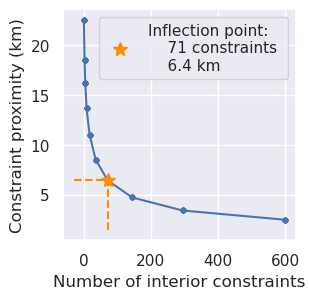

In [86]:
fig, ax = plt.subplots(figsize=(3, 3))

ax.plot(
    sampled_params_df.constraint_numbers,
    sampled_params_df.constraint_spacing,
    "o-",
    markersize=3,
)
ax.plot(
    df.iloc[elbow_ind].constraint_numbers,
    df.iloc[elbow_ind].constraint_spacing,
    "*",
    color="darkorange",
    markersize=10,
    label=f"Inflection point: \n    {int(df.iloc[elbow_ind].constraint_numbers)} constraints \n    {df.iloc[elbow_ind].constraint_spacing:.1f} km",
)
ax.vlines(
    df.iloc[elbow_ind].constraint_numbers,
    ymin=ax.get_ylim()[0],
    ymax=df.iloc[elbow_ind].constraint_spacing,
    linestyle="--",
    color="darkorange",
)
ax.hlines(
    df.iloc[elbow_ind].constraint_spacing,
    xmin=ax.get_xlim()[0],
    xmax=df.iloc[elbow_ind].constraint_numbers,
    linestyle="--",
    color="darkorange",
)
ax.legend()
ax.set_ylabel("Constraint proximity (km)")
ax.set_xlabel("Number of interior constraints")

fig.savefig(
    "../../paper/figures/Ross_Sea_spacing_vs_number_elbow.png",
    dpi=300,
    bbox_inches="tight",
)

In [5]:
sampled_params_df.describe()

,constraint_numbers,regional_strengths,constraint_spacing,constraints_per_10000sq_km,constraints_starting_rmse,starting_bathymetry_mae,starting_bathymetry_rmse,regional_stdev,regional_error,gravity_anomaly_rms,best_damping,constraints_rmse,inversion_rmse,inversion_mae,topo_improvement_rmse,topo_improvement_mae
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,1.000000e+02,100.000000,100.000000,100.000000,100.000000,100.000000
mean,117.500000,75.000000,10.747000,320.233333,0.063756,23.647352,37.697484,15.343445,3.029809,36.590905,2.500000e-02,3.352784,57.437749,42.165921,-19.740265,-18.518568
std,184.157514,48.112173,6.507097,60.904343,0.086528,16.932126,27.047432,9.842753,3.581821,3.942710,6.973851e-18,2.971144,66.862833,50.075256,53.390157,40.504433
min,0.000000,0.000000,2.489000,281.333333,0.000000,3.930911,6.619145,0.000000,0.073429,32.377824,2.500000e-02,0.309218,2.432941,1.597327,-181.318160,-137.810442
25%,4.000000,33.330000,4.721000,282.666667,0.005607,8.819589,14.842533,6.818627,0.178795,32.917397,2.500000e-02,0.994876,4.144587,2.999847,-39.673426,-33.499742
50%,26.000000,75.000000,9.762500,290.000000,0.022390,21.108333,34.539916,15.343445,1.440511,35.507798,2.500000e-02,2.240716,27.135208,18.931154,3.316918,0.283995
75%,144.000000,116.670000,16.224000,329.333333,0.081004,32.589979,49.757402,23.868264,4.956468,39.730868,2.500000e-02,5.209836,93.933619,66.900597,8.258731,3.782566
max,600.000000,150.000000,22.522000,480.000000,0.269469,61.499791,100.670466,30.686891,13.714867,44.036672,2.500000e-02,12.263669,256.629758,199.310233,97.254955,59.137107


In [6]:
sampled_params_df[["regional_strengths", "regional_stdev"]]

,regional_strengths,regional_stdev
0,0.00,0.000000
1,16.67,3.410336
2,33.33,6.818627
3,50.00,10.228964
4,66.67,13.639300
...,...,...
95,83.33,17.047591
96,100.00,20.457927
97,116.67,23.868264
98,133.33,27.276554


## Predict ice shelves inversion MAE and topo improvement

In [7]:
ds = sampled_params_df.set_index(["constraint_spacing", "regional_stdev"]).to_xarray()

for p in ["reg_stdev", "topo_free_disturbance_stdev"]:
    for i, row in ice_shelf_stats_gdf.iterrows():
        inversion_mae = ds.inversion_mae.sel(
            constraint_spacing=row.median_constraint_distance,
            regional_stdev=row[p],
            method="nearest",
        ).values
        topo_improvement_mae = ds.topo_improvement_mae.sel(
            constraint_spacing=row.median_constraint_distance,
            regional_stdev=row[p],
            method="nearest",
        ).values
        ice_shelf_stats_gdf.loc[i, f"inversion_mae_from_{p}"] = inversion_mae
        ice_shelf_stats_gdf.loc[i, f"topo_improvement_mae_from_{p}"] = (
            topo_improvement_mae
        )

ice_shelf_stats_gdf

,NAME,Regions,TYPE,geometry,area_km,median_constraint_distance,gravity_disturbance_rms,gravity_disturbance_stdev,partial_topo_free_disturbance_rms,partial_topo_free_disturbance_stdev,...,error_rms,error_stdev,residual_constraint_proximity_ratio_rms,residual_constraint_proximity_ratio_stdev,regional_constraint_proximity_ratio_rms,regional_constraint_proximity_ratio_stdev,inversion_mae_from_reg_stdev,topo_improvement_mae_from_reg_stdev,inversion_mae_from_topo_free_disturbance_stdev,topo_improvement_mae_from_topo_free_disturbance_stdev
0,Ross,West,FL,POLYGON ((-240677.18377991652 -678259.00593521...,480428.0,16.438369,44.934094,14.663219,43.662103,14.661921,...,12.748633,3.154937,109411.809927,108973.906512,2.645335e+05,2.465043e+05,90.275171,-57.685192,90.275171,-57.685192
1,Ronne_Filchner,West,FL,POLYGON ((-1006734.8906412432 880592.979674786...,427042.0,7.164803,41.514238,18.769872,41.429561,18.760552,...,7.952294,1.760702,51031.817496,51000.501525,3.285126e+05,2.353756e+05,19.016057,-5.230381,19.016057,-5.230381
2,Amery,East,FL,POLYGON ((2134701.4219642165 618463.1172190169...,60797.0,15.183931,54.607713,44.217952,55.333792,44.152812,...,8.435324,0.503457,422143.617186,382878.269956,1.003772e+06,7.182766e+05,108.323576,-75.733596,144.452243,-111.862264
3,LarsenC,Peninsula,FL,POLYGON ((-2235724.269360441 1271352.187501361...,47444.0,8.870497,14.847744,13.588458,14.444266,13.464743,...,5.718122,1.274370,65632.760934,65551.197575,4.938188e+05,3.113619e+05,21.579239,-5.016893,21.579239,-5.016893
4,Riiser-Larsen,East,FL,POLYGON ((-592166.3173854565 1592824.257663729...,42913.0,16.583215,53.516817,37.949582,52.971480,37.978854,...,8.282689,0.712841,332133.545228,331949.811620,1.767678e+06,1.152930e+06,162.543929,-129.953950,162.543929,-129.953950
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159,Perkins,West,FL,POLYGON ((-1129608.7530223199 -1201300.7339383...,7.0,0.718792,33.593137,3.571592,33.666794,2.657778,...,8.757103,0.917573,815.726924,658.066937,2.512720e+04,6.331423e+03,1.677936,2.252975,1.677936,2.252975
160,Rose_Point,West,FL,POLYGON ((-1147927.178503945 -1208825.17199831...,7.0,0.832527,29.468264,0.981304,28.411324,0.779644,...,13.524648,0.287649,2784.396543,2089.018872,1.475005e+04,4.808885e+03,1.677936,2.252975,1.614859,2.316052
161,Arneb,East,FL,POLYGON ((333867.8249121742 -1897953.452471011...,6.0,0.640304,81.777387,11.153281,79.323918,11.615274,...,14.502661,0.200468,4449.608717,3631.934312,4.377760e+04,1.954008e+04,1.617709,2.313202,1.669182,2.261728
162,Falkner,East,FL,POLYGON ((425350.5316694485 -1726631.609486937...,6.0,0.562234,35.906908,3.341045,36.851665,2.682288,...,13.782112,0.230442,7055.978937,5600.410731,3.084200e+04,9.409904e+03,1.614859,2.316052,1.617709,2.313202


In [8]:
# predict_on = "partial_topo_free_disturbance_stdev"
predict_on = "topo_free_disturbance_stdev"
# predict_on = "reg_stdev"

In [9]:
# # predict inversion_mae
# ice_shelf_stats_gdf = gravity_processing.verde_predict_trend(
#     data_to_fit=sampled_params_df,
#     cols_to_fit=["constraint_spacing", "regional_stdev", "inversion_mae"],
#     data_to_predict=ice_shelf_stats_gdf,
#     cols_to_predict=["median_constraint_distance", predict_on, "inversion_mae"],
#     degree=6,
# )
# # predict topo_improvement_mae
# ice_shelf_stats_gdf = gravity_processing.verde_predict_trend(
#     data_to_fit=sampled_params_df,
#     cols_to_fit=["constraint_spacing", "regional_stdev", "topo_improvement_mae"],
#     data_to_predict=ice_shelf_stats_gdf,
#     cols_to_predict=["median_constraint_distance", predict_on, "topo_improvement_mae"],
#     degree=4,
# )

shelves_to_plot = ice_shelf_stats_gdf.copy()

# shelves_to_plot = shelves_to_plot[
#     shelves_to_plot.median_constraint_distance.between(
#         sampled_params_df.constraint_spacing.min(),
#         sampled_params_df.constraint_spacing.max(),
#     )
#     & shelves_to_plot[predict_on].between(
#         sampled_params_df.regional_stdev.min(),
#         sampled_params_df.regional_stdev.max(),
#     )
# ].reset_index(drop=True)

# plot only the largest shelves which fall in the ensemble limits
shelves_to_plot = shelves_to_plot[shelves_to_plot.NAME.isin(ice_shelves.iloc[0:].NAME)]
shelves_to_plot.NAME.unique()

array(['Ross', 'Ronne_Filchner', 'Amery', 'LarsenC', 'Riiser-Larsen',
       'Fimbul', 'Brunt_Stancomb', 'Getz', 'Baudouin', 'Abbot',
       'Shackleton', 'George_VI', 'LarsenD', 'Borchgrevink', 'West',
       'Wilkins', 'Sulzberger', 'Jelbart', 'Lazarev', 'Stange', 'Nivl',
       'Ekstrom', 'Nickerson', 'Totten', 'Pine_Island',
       'Moscow_University', 'Dotson', 'Mertz', 'Prince_Harald',
       'Thwaites', 'Bach', 'Cook', 'Crosson', 'Rennick', 'Venable',
       'Cosgrove', 'Tracy_Tremenchus', 'Mariner', 'Holmes', 'Drygalski',
       'LarsenB', 'Quar', 'Vigrid', 'Atka', 'Nansen', 'Ninnis',
       'Conger_Glenzer', 'Publications', 'Dibble', 'LarsenE',
       'Vincennes_Bay', 'WilmaRobertDowner', 'Swinburne', 'Shirase',
       'LarsenF', 'Aviator', 'Lillie', 'LarsenA', 'Voyeykov',
       'Rayner_Thyer', 'Land', 'Withrow', 'Lauritzen', 'Mendelssohn',
       'Tucker', 'Edward_VIII', 'LarsenG', 'Hannan', 'Fitzgerald',
       'Mulebreen', 'Helen', 'Wordie', 'Slava', 'Williamson', 'Zubchat

In [10]:
sampled_params_df[
    ["constraint_numbers", "constraints_per_10000sq_km", "constraint_spacing"]
]

,constraint_numbers,constraints_per_10000sq_km,constraint_spacing
0,0,281.333333,22.522
1,0,281.333333,22.522
2,0,281.333333,22.522
3,0,281.333333,22.522
4,0,281.333333,22.522
...,...,...,...
95,600,480.000000,2.489
96,600,480.000000,2.489
97,600,480.000000,2.489
98,600,480.000000,2.489


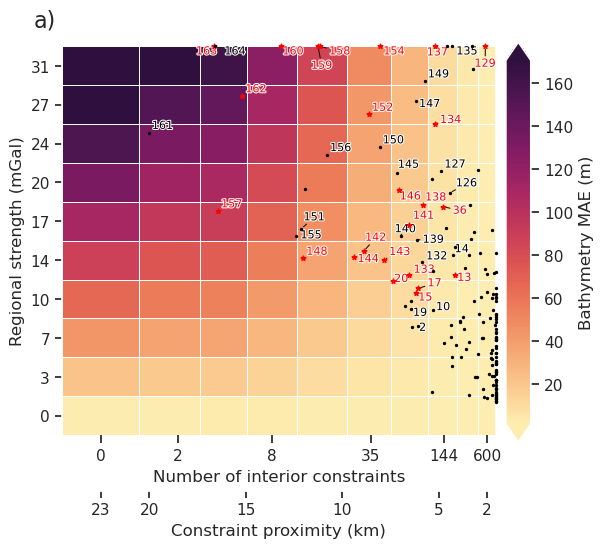

In [137]:
fig = RIS_plotting.plot_2var_ensemble(
    sampled_params_df,
    figsize=(5, 5),
    x="constraint_spacing",
    x_title="Constraint proximity (km)",
    # x="constraint_numbers",
    # x_title="Number of constraints",
    # x="constraints_per_10000sq_km",
    # x_title="Constraints per 10000 $km^2$",
    y="regional_stdev",
    y_title="Regional strength (mGal)",
    background="inversion_mae",
    background_title="Bathymetry MAE (m)",
    background_robust=True,
    # background_cpt_lims=(0, 80),
    background_cpt_lims=polar_utils.get_min_max(
        sampled_params_df.inversion_mae,
        robust=True,
        # robust_percentiles=(0.05, 0.85),
    ),
    # logx=True,
    flipx=True,
    # plot_title=f"Predicting on {predict_on}",
)
ax = fig.get_axes()[0]
plt.gcf().text(0.1, 1.02, "a)", fontsize=16, va="bottom", ha="right")


# specify x ticks
ax.grid(True)
vals = np.arange(
    5,
    sampled_params_df.constraint_spacing.unique().max(),
    5,
).tolist()
vals.insert(0, sampled_params_df.constraint_spacing.unique().max())
vals.insert(1, sampled_params_df.constraint_spacing.unique().min())
ax.set_xticks(vals)
ax.set_xticklabels(vals)
for axis in [ax.xaxis]:
    formatter = mpl.ticker.ScalarFormatter()
    formatter.set_scientific(False)
    axis.set_major_formatter(formatter)
    axis.set_major_formatter(mpl.ticker.FormatStrFormatter("%.0f"))
ax.spines["bottom"].set_position(("outward", 40))


vals = sampled_params_df.constraint_spacing.unique()
vals_original = [vals[0], vals[1], vals[3], vals[5], vals[7], vals[-1]]

# add second x axis just change labels not values
ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
# ax2.set_xscale("log")

new_vals = sampled_params_df.constraint_numbers.unique()
new_vals = [
    new_vals[0],
    new_vals[1],
    new_vals[3],
    new_vals[5],
    new_vals[7],
    new_vals[-1],
]
# labels = [round(x) for x in list(sampled_params_df.constraint_numbers.unique()[::1])]
ax2.set_xticks(vals_original)
labels = [round(x) for x in new_vals]

ax2.set_xticklabels(labels)
ax2.grid(False)
ax2.set_xlabel("Number of interior constraints")
ax2.xaxis.set_ticks_position("bottom")
ax2.xaxis.set_label_position("bottom")
# ax2.spines["bottom"].set_position(("outward", 40))
ax2.spines[["right", "left", "top", "bottom"]].set_visible(False)

# specify y ticks
yvals = list(sampled_params_df.regional_stdev.unique())
ax.set_yticks(yvals)
ax.set_yticklabels([round(x) for x in yvals])
ax.tick_params(
    axis="both",
    which="both",
    length=5,
    bottom=True,
    left=True,
)

df = shelves_to_plot.sort_values(
    f"topo_improvement_mae_from_{predict_on}", ascending=False
)
# df = shelves_to_plot.sort_values(f"inversion_mae_from_{predict_on}", ascending=True)
ice_shelf_stats.add_shelves_to_ensembles(
    x="median_constraint_distance",
    y=predict_on,
    ice_shelves=df,
    shelves_to_label=df[df.NAME.isin(ice_shelves.iloc[0:40].NAME)].NAME.unique(),
    ax=ax,
    legend=False,
    # col_to_add_to_label=f"topo_improvement_mae_from_{predict_on}",
    # col_to_add_to_label=f"inversion_mae_from_{predict_on}",
)

plt.minorticks_off()

fig.savefig(
    "../../paper/figures/Ross_Sea_constraint_vs_regional_ensemble_bathy_error_2var.png",
    bbox_inches="tight",
)

In [14]:
# ax2 = ax.twiny()
# ax2.set_xticks(vals)
# vals = [round(x) for x in sampled_params_df.constraint_spacing.unique()][::2]
# vals.append(round(sampled_params_df.constraint_spacing.unique()[-1]))
# ax2.set_xticklabels(vals)
# ax2.xaxis.set_ticks_position("bottom")
# ax2.xaxis.set_label_position("bottom")
# ax2.spines["bottom"].set_position(("outward", 40))
# ax2.set_xlim(ax.get_xlim())
# ax2.grid(False)
# ax2.set_xlabel("Constraints distance (km)")

# # fig = plt.gcf()

# fig.savefig("../../paper/figures/Ross_Sea_constraint_vs_regional_ensemble_bathy_error_2var.png", bbox_inches="tight")
# fig

In [15]:
# fig = RIS_plotting.plot_2var_ensemble(
#     sampled_params_df,
#     figsize=(6, 4),
#     x="constraint_spacing",
#     x_title="Constraint spacing (km)",
#     # x="constraints_per_10000sq_km",
#     # x_title="Constraints per 10000 $km^2$",
#     y="regional_rms",
#     y_title="Regional field strength (mGal)",
#     background="inversion_mae",
#     background_title="Bathymetry MAE (m)",
#     # plot_title="Constraint spacing vs regional strength",
#     background_robust=True,
#     # logx=True,
#     flipx=True,
# )

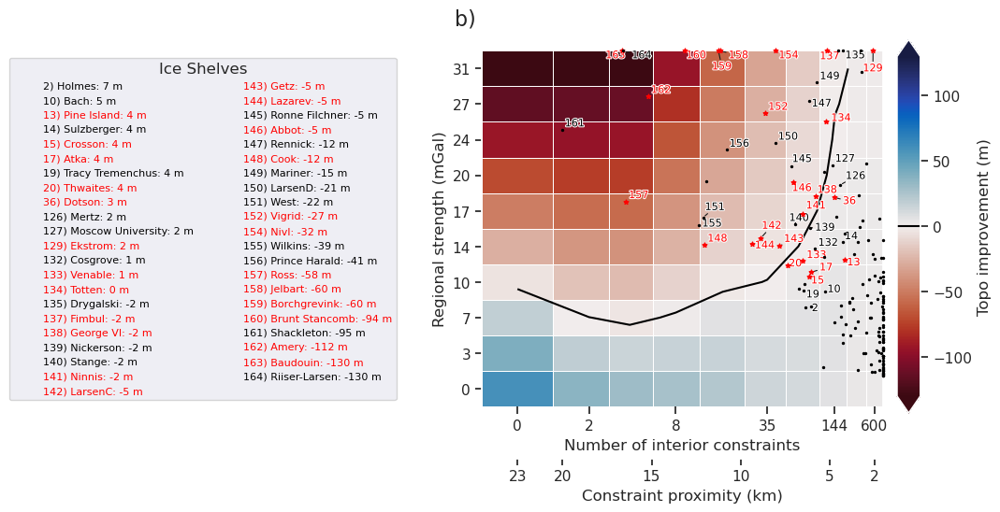

In [138]:
df = sampled_params_df  # [sampled_params_df.constraint_numbers > 2]
fig = RIS_plotting.plot_2var_ensemble(
    df,
    figsize=(5, 5),
    x="constraint_spacing",
    x_title="Constraint proximity (km)",
    # x="constraint_numbers",
    # x_title="Number of constraints",
    # x="constraints_per_10000sq_km",
    # x_title="Constraints per 10000 $km^2$",
    y="regional_stdev",
    y_title="Regional strength (mGal)",
    background="topo_improvement_mae",
    background_title="Topo improvement (m)",
    background_cmap="cmo.balance_r",
    background_robust=True,
    # background_cpt_lims=(-30, 30),
    background_cpt_lims=polar_utils.get_min_max(
        df.topo_improvement_mae,
        robust=True,
        absolute=True,
        # robust_percentiles=(0.05, 0.95),
    ),
    plot_contours=[0],
    contour_color="black",
    # logx=True,
    # plot_title=f"Predicting on {predict_on}",
    flipx=True,
)
ax = fig.get_axes()[0]

plt.gcf().text(0.1, 1.02, "b)", fontsize=16, va="bottom", ha="right")

# specify x ticks
ax.grid(True)
vals = np.arange(
    5,
    sampled_params_df.constraint_spacing.unique().max(),
    5,
).tolist()
vals.insert(0, sampled_params_df.constraint_spacing.unique().max())
vals.insert(1, sampled_params_df.constraint_spacing.unique().min())
ax.set_xticks(vals)
ax.set_xticklabels(vals)
for axis in [ax.xaxis]:
    formatter = mpl.ticker.ScalarFormatter()
    formatter.set_scientific(False)
    axis.set_major_formatter(formatter)
    axis.set_major_formatter(mpl.ticker.FormatStrFormatter("%.0f"))
ax.spines["bottom"].set_position(("outward", 40))

vals = sampled_params_df.constraint_spacing.unique()
vals_original = [vals[0], vals[1], vals[3], vals[5], vals[7], vals[-1]]

# add second x axis just change labels not values
ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
# ax2.set_xscale("log")

new_vals = sampled_params_df.constraint_numbers.unique()
new_vals = [
    new_vals[0],
    new_vals[1],
    new_vals[3],
    new_vals[5],
    new_vals[7],
    new_vals[-1],
]
# labels = [round(x) for x in list(sampled_params_df.constraint_numbers.unique()[::1])]
ax2.set_xticks(vals_original)
labels = [round(x) for x in new_vals]

ax2.set_xticklabels(labels)
ax2.grid(False)
ax2.set_xlabel("Number of interior constraints")
ax2.xaxis.set_ticks_position("bottom")
ax2.xaxis.set_label_position("bottom")
# ax2.spines["bottom"].set_position(("outward", 40))
ax2.spines[["right", "left", "top", "bottom"]].set_visible(False)

# specify y ticks
yvals = list(sampled_params_df.regional_stdev.unique())
ax.set_yticks(yvals)
ax.set_yticklabels([round(x) for x in yvals])
ax.tick_params(
    axis="both",
    which="both",
    length=5,
    bottom=True,
    left=True,
)

df = shelves_to_plot.sort_values(
    f"topo_improvement_mae_from_{predict_on}", ascending=False
)
# df = shelves_to_plot.sort_values(f"inversion_mae_from_{predict_on}", ascending=True)
ice_shelf_stats.add_shelves_to_ensembles(
    x="median_constraint_distance",
    y=predict_on,
    ice_shelves=df,
    shelves_to_label=df[df.NAME.isin(ice_shelves.iloc[0:40].NAME)].NAME.unique(),
    ax=ax,
    # legend=False,
    legend_cols=2,
    legend_loc="center right",
    legend_bbox_to_anchor=(-0.2, 0.5),
    col_to_add_to_label=f"topo_improvement_mae_from_{predict_on}",
    # col_to_add_to_label=f"inversion_mae_from_{predict_on}",
)

plt.minorticks_off()

fig.savefig(
    "../../paper/figures/Ross_Sea_constraint_vs_regional_ensemble_topo_improvement_2var.png",
    bbox_inches="tight",
)

Elbow x value: 11.011
Elbow x value: 16.224
Elbow x value: 16.224
Elbow x value: 16.224
Elbow x value: 16.224
Elbow x value: 16.224
Elbow x value: 16.224
Elbow x value: 16.224
Elbow x value: 16.224
Elbow x value: 16.224


Text(0.1, 0.95, 'c)')

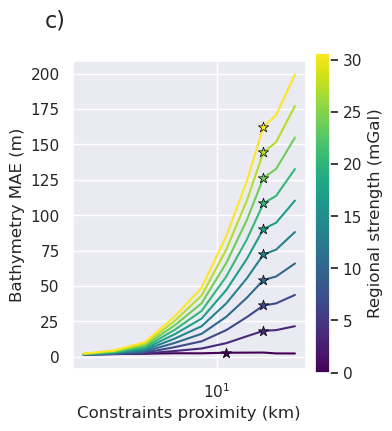

In [ ]:
fig = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    figsize=(3, 4),
    x="constraint_spacing",
    x_label="Constraints proximity (km)",
    # x="constraints_per_10000sq_km",
    # x_label="Constraints per 10000 $km^2$",
    # x="constraint_numbers",
    # x_label="Number of interior constraints",
    y="inversion_mae",
    y_label="Bathymetry MAE (m)",
    groupby_col="regional_stdev",
    cbar_label="Regional strength (mGal)",
    # horizontal_line=starting_bathymetry_rmse,
    # horizontal_line_label="Starting RMSE",
    # trend_line=True,
    # slope_min_max=True,
    # slope_mean=True,
    # logx=True,
    markersize=0,
    plot_elbows=True,
)
ax = fig.get_axes()[0]
plt.gcf().text(0.1, 0.95, "c)", fontsize=16, va="bottom", ha="right")

Elbow x value: 294
Elbow x value: 71
Elbow x value: 71
Elbow x value: 71
Elbow x value: 71
Elbow x value: 71


Text(0.1, 0.95, 'c)')

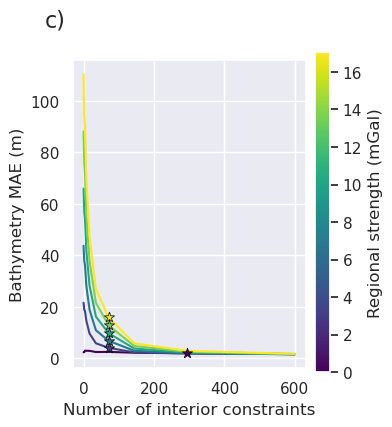

In [245]:
fig = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df[sampled_params_df.regional_stdev < 20],
    figsize=(3, 4),
    # x="constraint_spacing",
    # x_label="Constraints proximity (km)",
    # x="constraints_per_10000sq_km",
    # x_label="Constraints per 10000 $km^2$",
    x="constraint_numbers",
    x_label="Number of interior constraints",
    y="inversion_mae",
    y_label="Bathymetry MAE (m)",
    groupby_col="regional_stdev",
    cbar_label="Regional strength (mGal)",
    # horizontal_line=starting_bathymetry_rmse,
    # horizontal_line_label="Starting RMSE",
    # trend_line=True,
    # slope_min_max=True,
    # slope_mean=True,
    # logx=True,
    markersize=0,
    plot_elbows=True,
)
ax = fig.get_axes()[0]
plt.gcf().text(0.1, 0.95, "c)", fontsize=16, va="bottom", ha="right")

# # specify x ticks
# ax.grid(True)
# vals = list(sampled_params_df.constraint_numbers.unique()[::2])
# labels = vals
# ax.set_xticks(vals)
# ax.set_xticklabels(labels)
# # for axis in [ax.xaxis]:
# #     formatter = mpl.ticker.ScalarFormatter()
# #     formatter.set_scientific(False)
# #     axis.set_major_formatter(formatter)
# #     axis.set_major_formatter(mpl.ticker.FormatStrFormatter("%.0f"))

# plt.minorticks_off()

# # add second x axis just change labels not values
# ax2 = ax.twiny()
# ax2.set_xlim(ax.get_xlim())
# ax2.set_xscale("log")
# labels = [round(x) for x in list(sampled_params_df.constraint_spacing.unique()[::2])]
# ax2.set_xticks(vals)
# ax2.set_xticklabels(labels)
# ax2.grid(False)
# ax2.set_xlabel("Constraints proximity (km)")
# ax2.xaxis.set_ticks_position("bottom")
# ax2.xaxis.set_label_position("bottom")
# ax2.spines["bottom"].set_position(("outward", 40))
# ax2.spines[['right', 'left', 'top', 'bottom']].set_visible(False)
# plt.minorticks_off()

# plt.savefig(
#     "../../paper/figures/Ross_Sea_constraint_vs_regional_ensemble_bathy_error_vs_constraint_spacing.png",
#     bbox_inches="tight",
# )

In [238]:
sampled_params_df[["constraint_spacing", "constraint_numbers"]].drop_duplicates()

,constraint_spacing,constraint_numbers
0,22.522,0
10,18.506,2
20,16.224,4
30,13.640,8
40,11.011,17
50,8.514,35
60,6.427,71
70,4.721,144
80,3.416,294
90,2.489,600


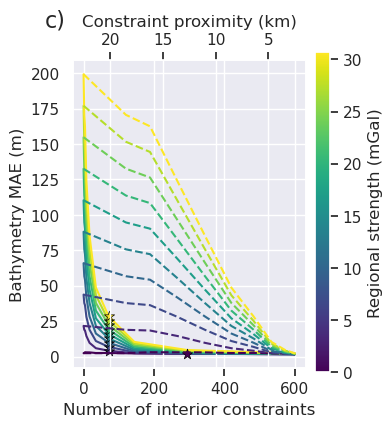

In [ ]:
ax2 = ax.twiny()
groupby_col = "regional_stdev"
results = sampled_params_df
x = "constraint_spacing"
y = "inversion_mae"
grouped = results.groupby(groupby_col)
# ax2.set_xscale("log")
norm = plt.Normalize(
    vmin=results[groupby_col].values.min(), vmax=results[groupby_col].values.max()
)
slopes = []
lines = []
for _, (name, group) in enumerate(grouped):
    ax2.plot(
        group[x],
        group[y],
        "--",
        markersize=0,
        color=plt.cm.viridis(norm(name)),
    )
ax2.invert_xaxis()
ax2.set_xlabel("Constraint proximity (km)")

fig.savefig(
    "../../paper/figures/Ross_Sea_constraint_vs_regional_ensemble_bathy_error_vs_constraint_spacing.png",
    bbox_inches="tight",
)
fig

In [14]:
# fig = RIS_plotting.plot_ensemble_as_lines(
#     sampled_params_df,
#     figsize = (8,4),

#     # x="constraint_spacing",
#     # x_label="Constraint spacing (km)",

#     x="constraints_per_10000sq_km",
#     x_label="Constraints per 10000 $km^2$",

#     # x="number_of_constraints",
#     # x_label="Number of constraints",

#     y="inversion_mae",
#     y_label="Bathymetry MAE (m)",

#     groupby_col="regional_rms",
#     cbar_label="Regional gravity strength (mGal)",
#     # trend_line=True,
#     # horizontal_line=starting_bathymetry_rmse,
#     # horizontal_line_label="Starting RMSE",
#     # slope_min_max=True,
#     # slope_mean=True,
# )
# plt.gcf().text(0.1, .95, "g)", fontsize=16, va="bottom", ha="right")
# plt.savefig('../../paper/figures/ensemble_1_bathy_error_vs_constraint_density.png', bbox_inches='tight')

Text(0.1, 0.95, 'e)')

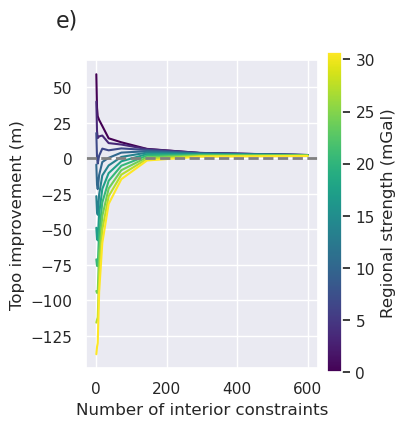

In [247]:
fig = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df,  # [sampled_params_df.constraint_numbers > 4],
    figsize=(3, 4),
    # x="constraint_spacing",
    # x_label="Constraints distance (km)",
    # x="constraints_per_10000sq_km",
    # x_label="Constraints per 10000 $km^2$",
    x="constraint_numbers",
    x_label="Number of interior constraints",
    y="topo_improvement_mae",
    y_label="Topo improvement (m)",
    groupby_col="regional_stdev",
    cbar_label="Regional strength (mGal)",
    horizontal_line=0,
    # horizontal_line_label="Starting RMSE",
    # horizontal_line_color="cyan",
    # trend_line=True,
    # slope_min_max=True,
    # slope_mean=True,
    # trend_line_text_loc=(0.05, 0.2),
    # logx=True,
    # y_lims=(0, 40),
    markersize=0,
    # plot_elbows=True,
)
ax = fig.get_axes()[0]
plt.gcf().text(0.1, 0.95, "e)", fontsize=16, va="bottom", ha="right")
# plt.savefig(
#     "../../paper/figures/Ross_Sea_constraint_vs_regional_ensemble_topo_improvement_vs_constraint_spacing.png",
#     bbox_inches="tight",
# )

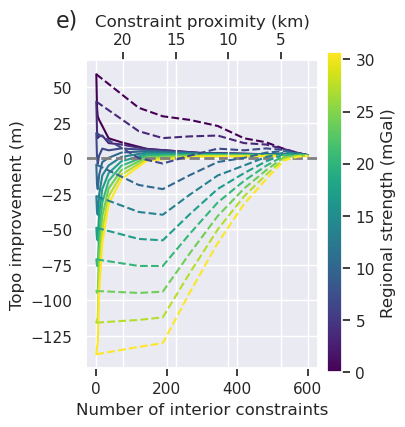

In [150]:
ax2 = ax.twiny()
groupby_col = "regional_stdev"
results = sampled_params_df
x = "constraint_spacing"
y = "topo_improvement_mae"
grouped = results.groupby(groupby_col)

norm = plt.Normalize(
    vmin=results[groupby_col].values.min(), vmax=results[groupby_col].values.max()
)
slopes = []
lines = []
for _, (name, group) in enumerate(grouped):
    ax2.plot(
        group[x],
        group[y],
        "--",
        markersize=0,
        color=plt.cm.viridis(norm(name)),
    )
ax2.invert_xaxis()
ax2.set_xlabel("Constraint proximity (km)")
fig.savefig(
    "../../paper/figures/Ross_Sea_constraint_vs_regional_ensemble_topo_improvement_vs_constraint_spacing.png",
    bbox_inches="tight",
)
fig

In [16]:
# fig = RIS_plotting.plot_ensemble_as_lines(
#     sampled_params_df,
#     figsize = (8,4),

#     # x="constraint_spacing",
#     # x_label="Constraint spacing (km)",

#     x="constraints_per_10000sq_km",
#     x_label="Constraints per 10000 $km^2$",

#     y="topo_improvement_mae",
#     y_label="Topo improvement (m)",

#     groupby_col="regional_rms",
#     cbar_label="Regional gravity strength (mGal)",
#     # trend_line=True,
#     # horizontal_line=0,
#     # horizontal_line_label="Starting RMSE",
#     # slope_min_max=True,
#     # slope_mean=True,
#     # logx=True,
# )
# plt.gcf().text(0.1, .95, "h)", fontsize=16, va="bottom", ha="right")
# plt.savefig('../../paper/figures/ensemble_1_topo_improvement_vs_constraint_density.png', bbox_inches='tight')

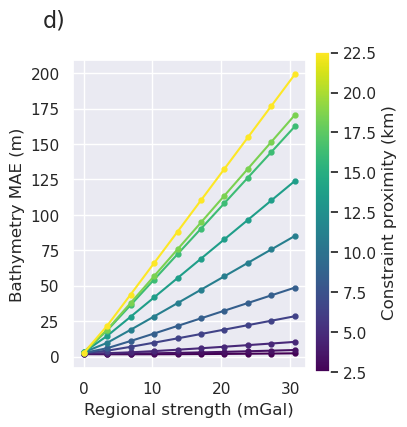

In [146]:
fig = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    figsize=(3, 4),
    x="regional_stdev",
    x_label="Regional strength (mGal)",
    y="inversion_mae",
    y_label="Bathymetry MAE (m)",
    groupby_col="constraint_spacing",
    cbar_label="Constraint proximity (km)",
    # groupby_col="constraint_numbers",
    # cbar_label="Number of constraints",
    # groupby_col="constraints_per_10000sq_km",
    # cbar_label="Constraints per 10000 $km^2$",
    # horizontal_line=starting_bathymetry_rmse,
    # horizontal_line_label="Starting RMSE",
    # trend_line=True,
    # slope_min_max=True,
    # slope_mean=True,
)
plt.gcf().text(0.1, 0.95, "d)", fontsize=16, va="bottom", ha="right")
plt.savefig(
    "../../paper/figures/Ross_Sea_constraint_vs_regional_ensemble_bathy_error_vs_regional_strength.png",
    bbox_inches="tight",
)

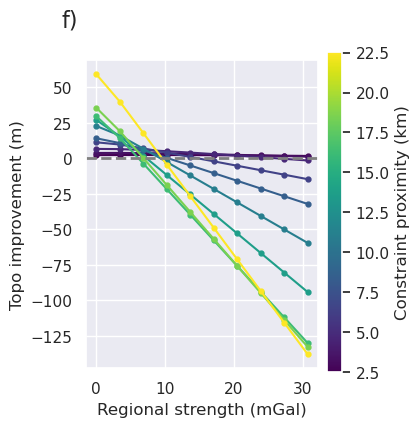

In [145]:
fig = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    figsize=(3, 4),
    x="regional_stdev",
    x_label="Regional strength (mGal)",
    y="topo_improvement_mae",
    y_label="Topo improvement (m)",
    groupby_col="constraint_spacing",
    cbar_label="Constraint proximity (km)",
    # groupby_col="constraints_per_10000sq_km",
    # cbar_label="Constraints per 10000 $km^2$",
    horizontal_line=0,
    # horizontal_line_label="Starting RMSE",
    # horizontal_line_color="cyan",
    # trend_line=True,
    # slope_min_max=True,
    # slope_mean=True,
    # trend_line_text_loc=(0.05, 0.2),
)
plt.gcf().text(0.1, 0.95, "f)", fontsize=16, va="bottom", ha="right")
plt.savefig(
    "../../paper/figures/Ross_Sea_constraint_vs_regional_ensemble_topo_improvement_vs_regional_strength.png",
    bbox_inches="tight",
)

### Correlation between true regional strength and partial topo-corrected disturbance
* we want to estimate where ice shelves would fall on the above plots
* need to estimate shelve's regional std. and constraint spacing
* 

In [ ]:
for i, row in sampled_params_df.iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)

    sampled_params_df.loc[i, "misfit_stdev"] = grav_df.misfit.std()
    sampled_params_df.loc[i, "grav_anom_stdev"] = grav_df.gravity_anomaly.std()
    sampled_params_df.loc[i, "estimated_regional_stdev"] = grav_df.reg.std()
    sampled_params_df.loc[i, "estimated_residual_stdev"] = grav_df.res.std()
    sampled_params_df.loc[i, "reg_res_ratio_stdev"] = (grav_df.reg / grav_df.res).std()
    sampled_params_df.loc[i, "reg_constraint_spacing_ratio_stdev"] = (
        grav_df.reg / row.constraint_spacing
    ).std()
    sampled_params_df.loc[i, "reg_constraint_num_ratio_stdev"] = (
        grav_df.reg / row.constraint_numbers
    ).std()

sampled_params_df["estimated_regional_stdev_constraint_spacing_ratio"] = (
    sampled_params_df.estimated_regional_stdev
    / (1 / sampled_params_df.constraint_spacing)
)
sampled_params_df["grav_anom_stdev_constraint_spacing_ratio"] = (
    sampled_params_df.grav_anom_stdev / (1 / sampled_params_df.constraint_spacing)
)
sampled_params_df["misfit_stdev_constraint_spacing_ratio"] = (
    sampled_params_df.misfit_stdev / (1 / sampled_params_df.constraint_spacing)
)
sampled_params_df["reg_res_stdev_ratio"] = (
    sampled_params_df.estimated_regional_stdev
    / sampled_params_df.estimated_residual_stdev
)
sampled_params_df["reg_misfit_stdev_ratio"] = (
    sampled_params_df.estimated_regional_stdev / sampled_params_df.misfit_stdev
)
sampled_params_df["regional_misfit_stdev_ratio"] = (
    sampled_params_df.regional_stdev / sampled_params_df.misfit_stdev
)

sampled_params_df.head()

In [ ]:
sampled_params_df[
    [
        "regional_stdev",
        "estimated_regional_stdev",
        "reg_constraint_spacing_ratio_stdev",
        "reg_constraint_num_ratio_stdev",
    ]
]

In [ ]:
sampled_params_df["regional_strength_estimation"] = (
    sampled_params_df.regional_stdev - sampled_params_df.estimated_regional_stdev
)

fig = RIS_plotting.plot_2var_ensemble(
    sampled_params_df,
    figsize=(6, 4),
    x="constraint_spacing",
    x_title="Constraint distance (km)",
    y="regional_stdev",
    y_title="Regional field standard deviation (mGal)",
    background="regional_strength_estimation",
    background_title="estimated_regional_stdev",
    background_robust=True,
    background_cmap="cmo.balance",
    background_cpt_lims=(-5, 5),
    # background_cpt_lims=polar_utils.get_min_max(
    #     sampled_params_df.inversion_mae,
    #     robust=True,
    #     robust_percentiles=(0.05, 0.85),
    # ),
    logx=True,
    # flipx=True,
)

In [ ]:
sampled_params_df.plot(
    x="regional_stdev",
    y="misfit_stdev",
    kind="scatter",
    c="constraint_spacing",
)

In [ ]:
sampled_params_df.plot(
    x="regional_stdev",
    y="grav_anom_stdev",
    kind="scatter",
    c="constraint_spacing",
)

In [ ]:
sampled_params_df.plot(
    x="regional_stdev",
    y="estimated_regional_stdev",
    kind="scatter",
    c="constraint_spacing",
)

In [ ]:
sampled_params_df["region_anom_stdev_ratio"] = (
    sampled_params_df.estimated_regional_stdev / sampled_params_df.grav_anom_stdev
)
sampled_params_df.plot(
    x="regional_stdev",
    y="region_anom_stdev_ratio",
    kind="scatter",
    c="constraint_spacing",
)

In [ ]:
anoms = [
    "misfit_stdev",
    "grav_anom_stdev",
    "estimated_regional_stdev",
    "estimated_residual_stdev",
    "reg_res_ratio_stdev",
    "reg_res_stdev_ratio",
    "reg_misfit_stdev_ratio",
    "reg_constraint_spacing_ratio_stdev",
    "reg_constraint_num_ratio_stdev",
    "grav_anom_stdev_constraint_spacing_ratio",
    "misfit_stdev_constraint_spacing_ratio",
]
reg_stats = [
    "regional_stdev",
    "regional_misfit_stdev_ratio",
]
df = sampled_params_df[anoms + reg_stats].corr()[reg_stats].drop(reg_stats)
sns.heatmap(
    df,
    robust=True,
    annot=True,
    # vmin=0.5,
    # vmax=0.98,
)
plt.title("Constraint spacing vs Regional strength", fontsize=15)

df

In [ ]:
sampled_params_df

In [ ]:
anoms = [
    # "misfit_stdev",
    # "grav_anom_stdev",
    # "estimated_regional_stdev",
    # "estimated_residual_stdev",
    # "reg_res_ratio_stdev",
    # "reg_res_stdev_ratio",
    # "reg_misfit_stdev_ratio",
    "reg_constraint_spacing_ratio_stdev",
    "reg_constraint_num_ratio_stdev",
    "grav_anom_stdev_constraint_spacing_ratio",
    "misfit_stdev_constraint_spacing_ratio",
    "estimated_regional_stdev_constraint_spacing_ratio",
    "constraint_spacing",
    "constraint_numbers",
]
reg_stats = [
    "inversion_mae",
]
df = sampled_params_df[anoms + reg_stats].corr()[reg_stats].drop(reg_stats)
sns.heatmap(
    df,
    robust=True,
    annot=True,
    # vmin=0.5,
    # vmax=0.98,
)
plt.title("Constraint spacing vs Regional strength", fontsize=15)

df

# Ensembles 2-4: grav spacing vs noise

In [2]:
# low_ensemble_path = "../../results/Ross_Sea_09_grav_spacing_vs_noise_ensemble_no_regional"
# low_ensemble_path = "../../results/Ross_Sea_09_grav_spacing_vs_noise_ensemble_no_regional_noise_0_3_spacing_3_30"
# low_ensemble_path = "../../results/Ross_Sea_09_grav_spacing_vs_noise_ensemble_no_regional_100"
# low_ensemble_path = "../../results/Ross_Sea_08_grav_spacing_vs_noise_ensemble_no_regional_100_noise_then_survey"
low_ensemble_path = "../../results/Ross_Sea_08_grav_spacing_vs_noise_ensemble_low_regional_100_noise_then_survey"
low_ensemble_fname = f"{low_ensemble_path}.csv"
sampled_params_df_low_regional = pd.read_csv(low_ensemble_fname)

# strong_ensemble_path = "../../results/Ross_Sea_10_grav_spacing_vs_noise_ensemble_strong_regional"
# strong_ensemble_path = "../../results/Ross_Sea_10_grav_spacing_vs_noise_ensemble_strong_regional_noise_0_3_spacing_3_30"
# strong_ensemble_path = "../../results/Ross_Sea_10_grav_spacing_vs_noise_ensemble_strong_regional_100"
strong_ensemble_path = "../../results/Ross_Sea_09_grav_spacing_vs_noise_ensemble_strong_regional_100_noise_then_survey"
strong_ensemble_fname = f"{strong_ensemble_path}.csv"
sampled_params_df_strong_regional = pd.read_csv(strong_ensemble_fname)

# medium_ensemble_path = "../../results/Ross_Sea_11_grav_spacing_vs_noise_ensemble_medium_regional"
# medium_ensemble_path = "../../results/Ross_Sea_11_grav_spacing_vs_noise_ensemble_medium_regional_noise_0_3_spacing_3_30"
# medium_ensemble_path = "../../results/Ross_Sea_11_grav_spacing_vs_noise_ensemble_medium_regional_100"
medium_ensemble_path = "../../results/Ross_Sea_10_grav_spacing_vs_noise_ensemble_medium_regional_100_noise_then_survey"
medium_ensemble_fname = f"{medium_ensemble_path}.csv"
sampled_params_df_medium_regional = pd.read_csv(medium_ensemble_fname)

NameError: name 'pd' is not defined

In [249]:
bathymetry_path = pathlib.Path(low_ensemble_path + "_starting_bathymetry").with_suffix(
    ".nc"
)
starting_bathymetry = xr.open_dataarray(bathymetry_path)
starting_bathymetry = starting_bathymetry.sel(
    easting=slice(plot_region[0], plot_region[1]),
    northing=slice(plot_region[2], plot_region[3]),
)

constraints_path = pathlib.Path(low_ensemble_path + "_constraints").with_suffix(".csv")
constraint_points = pd.read_csv(constraints_path)

# starting_bathymetry_mae = None
starting_bathymetry_mae = float(np.mean(np.abs(bathymetry - starting_bathymetry)))
starting_bathymetry_rmse = float(utils.rmse(bathymetry - starting_bathymetry))

# contours = [starting_bathymetry_mae, 2*starting_bathymetry_mae]
contours = [starting_bathymetry_mae]

starting_bathymetry_mae, starting_bathymetry_rmse

(12.046641487544193, 20.510960115054807)

In [250]:
figsize = (4, 4)

cpt_lims = polar_utils.get_combined_min_max(
    [
        sampled_params_df_low_regional.inversion_mae,
        sampled_params_df_medium_regional.inversion_mae,
        sampled_params_df_strong_regional.inversion_mae,
    ],
    robust=True,
    robust_percentiles=(0.1, 0.9),
)
# line_plot_ylims = [cpt_lims[0]*.9, cpt_lims[1]*1.1]
line_plot_ylims = polar_utils.get_combined_min_max(
    [
        sampled_params_df_low_regional.inversion_mae,
        sampled_params_df_medium_regional.inversion_mae,
        sampled_params_df_strong_regional.inversion_mae,
    ],
)
line_plot_ylims = (line_plot_ylims[0] * 0.9, line_plot_ylims[1] * 1.1)

cpt_lims

(np.float64(7.696360850155769), np.float64(35.60961505304184))

## Low regional

In [251]:
sampled_params_df_low_regional.describe()

,grav_line_numbers,grav_noise_levels,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,best_damping,constraints_damping_cv_rmse,inversion_rmse,inversion_mae,topo_improvement_rmse,topo_improvement_mae,flight_kms,flight_kms_per_10000sq_km
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,1.000000e+02,1.000000e+02,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000
mean,12.200000,1.250000,23.969834,1.645644,1.215358,1.292945,1.292945,1.022830e+00,2.500000e-02,1.990159,24.435788,17.750409,-2.418387,-3.973273,4270.000000,1423.333333
std,8.596452,0.800946,16.579504,0.928143,0.679352,0.845587,0.845587,2.231632e-16,6.973851e-18,0.975909,9.781211,7.901784,9.781211,7.901784,3008.758259,1002.919420
min,3.000000,0.000000,5.833333,0.087881,0.046375,0.178376,0.178376,1.022830e+00,2.500000e-02,0.713135,4.942054,3.612147,-25.631528,-23.395026,1050.000000,350.000000
25%,5.000000,0.560000,9.722222,1.013168,0.673642,0.695409,0.695409,1.022830e+00,2.500000e-02,1.174375,17.649306,12.250786,-8.903698,-9.040059,1750.000000,583.333333
50%,9.500000,1.250000,18.892045,1.548823,1.213700,1.121153,1.121153,1.022830e+00,2.500000e-02,1.734137,24.113309,16.837781,-2.095909,-3.060645,3325.000000,1108.333333
75%,18.000000,1.940000,35.000000,2.215540,1.627976,1.577125,1.577125,1.022830e+00,2.500000e-02,2.590063,30.921098,22.817195,4.368094,1.526351,6300.000000,2100.000000
max,30.000000,2.500000,58.333333,3.848911,2.909423,3.472635,3.472635,1.022830e+00,2.500000e-02,4.789205,47.648929,37.172162,17.075346,10.164989,10500.000000,3500.000000


In [252]:
sampled_params_df_low_regional["regional_stdev"] = np.nan
for i, row in sampled_params_df_low_regional.iterrows():
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)
    sampled_params_df_low_regional.loc[i, "regional_stdev"] = float(
        grav_df.basement_grav.std()
    )

sampled_params_df_low_regional.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,...,best_damping,constraints_damping_cv_rmse,inversion_rmse,inversion_mae,inverted_bathymetry_fname,topo_improvement_rmse,topo_improvement_mae,flight_kms,flight_kms_per_10000sq_km,regional_stdev
0,3,0.00,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.414132,2.194327,3.117237,3.117237,1.02283,...,0.025,1.025609,23.456574,14.507253,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-1.439174,-0.730117,1050.0,350.0,1.022896
1,3,0.28,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.429783,2.236637,3.133555,3.133555,1.02283,...,0.025,1.075510,23.428339,14.552381,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-1.410938,-0.775245,1050.0,350.0,1.022896
2,3,0.56,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.454377,2.300388,3.156205,3.156205,1.02283,...,0.025,1.161874,23.678176,14.864379,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-1.660776,-1.087243,1050.0,350.0,1.022896
3,3,0.83,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.486386,2.371051,3.183914,3.183914,1.02283,...,0.025,1.272814,24.174831,15.425643,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-2.157430,-1.648506,1050.0,350.0,1.022896
4,3,1.11,../../results/Ross_Sea_08_grav_spacing_vs_nois...,../../results/Ross_Sea_08_grav_spacing_vs_nois...,58.333333,3.527941,2.450794,3.218570,3.218570,1.02283,...,0.025,1.409636,24.938757,16.201179,../../results/Ross_Sea_08_grav_spacing_vs_nois...,-2.921357,-2.424043,1050.0,350.0,1.022896


In [253]:
sampled_params_df_low_regional.columns

Index(['grav_line_numbers', 'grav_noise_levels', 'grav_df_fname',
       'grav_survey_df_fname', 'grav_line_spacing', 'grav_data_loss_rmse',
       'grav_data_loss_mae', 'regional_error', 'residual_error',
       'regional_rms', 'damping_cv_results_fname', 'best_damping',
       'constraints_damping_cv_rmse', 'inversion_rmse', 'inversion_mae',
       'inverted_bathymetry_fname', 'topo_improvement_rmse',
       'topo_improvement_mae', 'flight_kms', 'flight_kms_per_10000sq_km',
       'regional_stdev'],
      dtype='object')

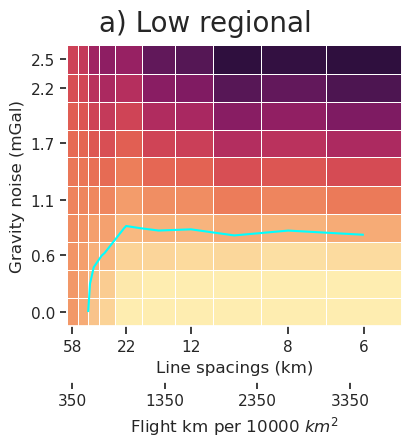

In [256]:
fig = RIS_plotting.plot_2var_ensemble(
    sampled_params_df_low_regional,
    figsize=figsize,
    # x="grav_line_spacing",
    # x_title="Line spacing (km)",
    x="flight_kms_per_10000sq_km",
    x_title="Flight km per 10000 $km^2$",
    # x="flight_kms",
    # x_title="Flight kms",
    # x="median_grav_distance",
    # x_title="Median gravity distance (m)",
    y="grav_noise_levels",
    y_title="Gravity noise (mGal)",
    background="inversion_mae",
    background_title="Bathymetry MAE (m)",
    background_robust=True,
    plot_contours=contours,
    contour_color="cyan",
    background_cpt_lims=cpt_lims,
    colorbar=False,
    # flipx=True,
    # logx=True,
)
bbox = dict(facecolor="lightgray", boxstyle="round")
# plt.gcf().text(0.1, 0.9, "a)", fontsize=16, va="bottom", ha="right")
# plt.gcf().text(0.5, 1.01, f"Low regional ({round(sampled_params_df_low_regional.regional_stdev.unique()[0])} mGal stdev)", fontsize=20, va="bottom", ha="center")
plt.gcf().text(0.5, 1.01, "a) Low regional", fontsize=20, va="bottom", ha="center")

ax = fig.get_axes()[0]

# specify x ticks
ax.grid(True)
vals = sampled_params_df_low_regional.flight_kms_per_10000sq_km.unique()
vals_original = [vals[0], vals[4], vals[6], vals[8], vals[-1]]
vals = np.arange(vals[0], vals[-1], 1000)
ax.set_xticks(vals)
ax.set_xticklabels([round(x) for x in vals])
ax.spines["bottom"].set_position(("outward", 40))

# add second x axis for line spacing
ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
new_vals = sampled_params_df_low_regional.grav_line_spacing.unique()
new_vals = [new_vals[0], new_vals[4], new_vals[6], new_vals[8], new_vals[-1]]
labels = [round(x) for x in new_vals]
ax2.set_xticks(vals_original)
ax2.set_xticklabels(labels)
ax2.grid(False)
ax2.set_xlabel("Line spacings (km)")
ax2.xaxis.set_ticks_position("bottom")
ax2.xaxis.set_label_position("bottom")

# specify y ticks
yvals = list(sampled_params_df_low_regional.grav_noise_levels.unique())[::2]
yvals.append(sampled_params_df_low_regional.grav_noise_levels.unique()[-1])
ax.set_yticks(yvals)
ax.set_yticklabels([round(x, 1) for x in yvals])
ax.tick_params(
    axis="both",
    which="both",
    length=5,
    bottom=True,
    left=True,
)
plt.minorticks_off()

fig.savefig(
    "../../paper/figures/Ross_Sea_noise_vs_spacing_low_regional_2var.png",
    bbox_inches="tight",
)

In [34]:
# ax2 = ax.twiny()
# ax2.set_xticks([vals[0], vals[4], vals[6], vals[8], vals[9]])

# vals = [int(x) for x in sampled_params_df_low_regional.grav_line_spacing.unique()]
# ax2.set_xticklabels([vals[0], vals[4], vals[6], vals[8], vals[9]])
# ax2.xaxis.set_ticks_position("bottom")
# ax2.xaxis.set_label_position("bottom")
# ax2.spines["bottom"].set_position(("outward", 40))
# ax2.set_xlim(ax.get_xlim())
# ax2.grid(False)
# ax2.set_xlabel("Line spacing (km)")

# fig.savefig("../../paper/figures/Ross_Sea_noise_vs_spacing_low_regional_2var.png", bbox_inches="tight")
# fig

In [35]:
# fig = RIS_plotting.plot_2var_ensemble(
#     sampled_params_df_low_regional,
#     figsize=figsize,

#     x="grav_line_spacing",
#     x_title="Line spacing (km)",
#     flipx=True,

#     # x="grav_line_numbers",
#     # x_title="Number of flight lines",

#     # x="flight_kms_per_10000sq_km",
#     # x_title="Flight km per 10000 $km^2$",

#     # x="flight_kms",
#     # x_title="Flight km",

#     y="grav_noise_levels",
#     y_title="Gravity noise (mGal)",
#     background="inversion_mae",
#     background_title="Bathymetry MAE (m)",
#     background_robust=True,
#     plot_contours=contours,
#     contour_color="cyan",
#     # background_cpt_lims=cpt_lims,

# )

In [36]:
# fig = RIS_plotting.plot_2var_ensemble(
#     sampled_params_df_low_regional,
#     figsize=figsize,

#     x="grav_line_spacing",
#     x_title="Line spacing (km)",
#     flipx=True,

#     # x="grav_line_numbers",
#     # x_title="Number of flight lines",

#     # x="flight_kms_per_10000sq_km",
#     # x_title="Flight km per 10000 $km^2$",

#     # x="flight_kms",
#     # x_title="Flight km",

#     y="grav_noise_levels",
#     y_title="Gravity noise (mGal)",
#     background="topo_improvement_mae",
#     background_title="Topo improvement (m)",
#     # background_robust=True,
#     # background_cpt_lims=(
#     #     0,
#     #     polar_utils.get_min_max(sampled_params_df_low_regional.topo_improvement_mae, robust=True)[1],
#     # ),
#     plot_contours=contours,
#     contour_color="cyan",
#     # background_cpt_lims=cpt_lims,

# )

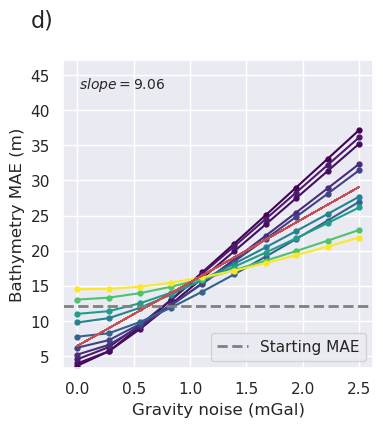

In [34]:
fig = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df_low_regional,
    figsize=figsize,
    # figsize=(4, 4),
    x="grav_noise_levels",
    x_label="Gravity noise (mGal)",
    y="inversion_mae",
    y_label="Bathymetry MAE (m)",
    groupby_col="grav_line_spacing",
    cbar_label="Line spacing (km)",
    # groupby_col="median_grav_distance",
    # cbar_label="Median gravity distance (m)",
    # groupby_col="flight_kms_per_10000sq_km",
    # cbar_label="Flight km per 10000 $km^2$",
    trend_line=True,
    horizontal_line=starting_bathymetry_mae,
    horizontal_line_label="Starting MAE",
    horizontal_line_label_loc="lower right",
    y_lims=line_plot_ylims,
    colorbar=False,
)
plt.gcf().text(0.1, 0.95, "d)", fontsize=16, va="bottom", ha="right")

plt.savefig(
    "../../paper/figures/Ross_Sea_noise_vs_spacing_low_regional_bathy_error_vs_grav_noise.png",
    bbox_inches="tight",
)

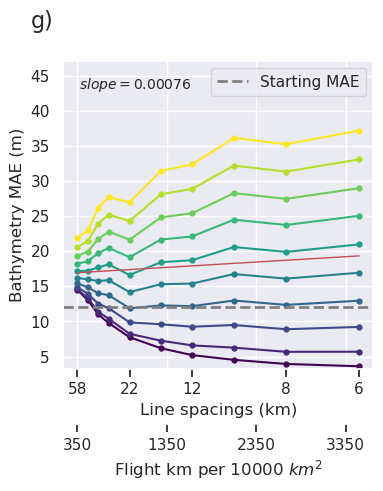

In [258]:
fig = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df_low_regional,
    figsize=figsize,
    # figsize=(5, 6),
    # x="grav_line_spacing",
    # x_label="Line spacing (km)",
    x="flight_kms_per_10000sq_km",
    x_label="Flight km per 10000 $km^2$",
    y="inversion_mae",
    y_label="Bathymetry MAE (m)",
    groupby_col="grav_noise_levels",
    cbar_label="Gravity noise (mGal)",
    trend_line=True,
    horizontal_line=starting_bathymetry_mae,
    horizontal_line_label="Starting MAE",
    horizontal_line_label_loc="upper right",
    y_lims=line_plot_ylims,
    # logx=True,
    colorbar=False,
    # plot_elbows=True,
)
plt.gcf().text(0.1, 0.95, "g)", fontsize=16, va="bottom", ha="right")

ax = fig.get_axes()[0]

# specify x ticks
ax.grid(True)
vals = sampled_params_df_low_regional.flight_kms_per_10000sq_km.unique()
vals_original = [vals[0], vals[4], vals[6], vals[8], vals[-1]]
vals = np.arange(vals[0], vals[-1], 1000)
ax.set_xticks(vals)
ax.set_xticklabels([round(x) for x in vals])
ax.spines["bottom"].set_position(("outward", 40))

# add second x axis for line spacing
ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
new_vals = sampled_params_df_low_regional.grav_line_spacing.unique()
new_vals = [new_vals[0], new_vals[4], new_vals[6], new_vals[8], new_vals[-1]]
labels = [round(x) for x in new_vals]
ax2.set_xticks(vals_original)
ax2.set_xticklabels(labels)
ax2.grid(False)
ax2.set_xlabel("Line spacings (km)")
ax2.xaxis.set_ticks_position("bottom")
ax2.xaxis.set_label_position("bottom")

plt.savefig(
    "../../paper/figures/Ross_Sea_noise_vs_spacing_low_regional_bathy_error_vs_grav_spacing.png",
    bbox_inches="tight",
)

In [39]:
# # subplots showing inverted bathymetry's
# grids = []
# cbar_labels = []
# row_titles = []
# column_titles = []

# # iterate over the ensemble starting with high noise, low line numbers
# # row per noise level and column per line spacing
# for i, row in sampled_params_df_low_regional.sort_values(by=["grav_noise_levels", "grav_line_spacing"], ascending=False,).iterrows():
#     inverted_bathymetry = xr.open_dataarray(row.inverted_bathymetry_fname)
#     reg = vd.pad_region(inversion_region, -3*spacing)
#     # reg = inversion_region
#     inverted_bathymetry = inverted_bathymetry.sel(
#         easting=slice(reg[0], reg[1]),
#         northing=slice(reg[2], reg[3]),
#     )
#     # add to lists
#     grids.append(inverted_bathymetry)
#     cbar_labels.append(f"MAE: {round(row.inversion_mae,2)} (m)")
#     if i % np.sqrt(len(sampled_params_df_low_regional)) == 0:
#         column_titles.append(f"Spacing: {round(row.grav_line_spacing)} km")
#     if i < np.sqrt(len(sampled_params_df_low_regional)):
#         row_titles.append(f"Noise: {round(row.grav_noise_levels,1)} mGal")

# fig = maps.subplots(
#     grids,
#     fig_height=8,
#     fig_title="Inverted bathymetry",
#     fig_title_font="75p,Helvetica-Bold,black",
#     fig_title_y_offset="5c",
#     cbar_labels=cbar_labels,
#     cmap="rain",
#     reverse_cpt=True,
#     # colorbar=False,
#     # hist=True,
#     cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
#     cbar_font="18p,Helvetica,black",
#     row_titles=row_titles,
#     column_titles=column_titles,
#     row_titles_font="25p,Helvetica,black",
#     column_titles_font="25p,Helvetica,black",
# )
# fig.show()

In [36]:
# subplots showing inverted bathymetry's
grids = []
cbar_labels = []
row_titles = []
column_titles = []

df = sampled_params_df_low_regional
# iterate over the ensemble starting with high noise, small line spacing
# row per noise level and column per line spacing
for i, row in df.sort_values(
    by=["grav_noise_levels", "grav_line_spacing"], ascending=[False, True]
).iterrows():
    inverted_bathymetry = xr.open_dataarray(row.inverted_bathymetry_fname)

    dif = bathymetry - inverted_bathymetry

    # reg = vd.pad_region(inversion_region, -3*spacing)
    reg = inversion_region
    inverted_bathymetry = inverted_bathymetry.sel(
        easting=slice(reg[0], reg[1]),
        northing=slice(reg[2], reg[3]),
    )
    dif = dif.sel(
        easting=slice(reg[0], reg[1]),
        northing=slice(reg[2], reg[3]),
    )
    # add to lists
    grids.append(inverted_bathymetry)
    grids.append(dif)
    cbar_labels.append(f"MAE: {round(row.inversion_mae,2)} m")
    cbar_labels.append(" ")
    if i % np.sqrt(len(df)) == 0:
        column_titles.append(round(row.grav_line_spacing))
        column_titles.append(" ")
    if i < np.sqrt(len(df)):
        row_titles.append(round(row.grav_noise_levels, 1))
        # row_titles.append(" ")

fig = maps.subplots(
    grids,
    dims=(np.sqrt(len(df)), 2 * np.sqrt(len(df))),
    fig_height=8,
    fig_title="Low regional field strength",
    fig_x_axis_title="Flight line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    fig_x_axis_title_y_offset="2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmaps=[x for xs in [["rain", "balance+h0"] for x in range(len(df))] for x in xs],
    reverse_cpt=True,
    # colorbar=False,
    # hist=True,
    # cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cpt_limits=[
        x
        for xs in [
            [
                polar_utils.get_combined_min_max(grids[::2], robust=True),
                polar_utils.get_combined_min_max(grids[1::2], robust=True),
            ]
            for x in range(len(df))
        ]
        for x in xs
    ],
    cbar_font="45p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    row_titles_font="70p,Helvetica,black",
    column_titles_font="70p,Helvetica,black",
)

fig.savefig(
    "../../paper/figures/Ross_Sea_ensemble_low_regional_inverted_bathymetry_and_errors.png",
    dpi=500,
)
fig.show()

## Medium regional

In [37]:
sampled_params_df_medium_regional["regional_stdev"] = np.nan
for i, row in sampled_params_df_medium_regional.iterrows():
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)
    sampled_params_df_medium_regional.loc[i, "regional_stdev"] = float(
        grav_df.basement_grav.std()
    )

sampled_params_df_medium_regional.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,...,best_damping,constraints_damping_cv_rmse,inversion_rmse,inversion_mae,inverted_bathymetry_fname,topo_improvement_rmse,topo_improvement_mae,flight_kms,flight_kms_per_10000sq_km,regional_stdev
0,3,0.00,../../results/Ross_Sea_10_grav_spacing_vs_nois...,../../results/Ross_Sea_10_grav_spacing_vs_nois...,58.333333,4.883142,2.886299,4.657646,4.657646,10.228297,...,0.025,1.146788,25.387152,16.653530,../../results/Ross_Sea_10_grav_spacing_vs_nois...,-3.369752,-2.876394,1050.0,350.0,10.228964
1,3,0.28,../../results/Ross_Sea_10_grav_spacing_vs_nois...,../../results/Ross_Sea_10_grav_spacing_vs_nois...,58.333333,4.900600,2.926960,4.673702,4.673702,10.228297,...,0.025,1.174083,25.337010,16.617349,../../results/Ross_Sea_10_grav_spacing_vs_nois...,-3.319609,-2.840213,1050.0,350.0,10.228964
2,3,0.56,../../results/Ross_Sea_10_grav_spacing_vs_nois...,../../results/Ross_Sea_10_grav_spacing_vs_nois...,58.333333,4.924315,2.989385,4.694149,4.694149,10.228297,...,0.025,1.237107,25.551954,16.805536,../../results/Ross_Sea_10_grav_spacing_vs_nois...,-3.534554,-3.028400,1050.0,350.0,10.228964
3,3,0.83,../../results/Ross_Sea_10_grav_spacing_vs_nois...,../../results/Ross_Sea_10_grav_spacing_vs_nois...,58.333333,4.953025,3.060066,4.717889,4.717889,10.228297,...,0.025,1.326865,25.999681,17.243606,../../results/Ross_Sea_10_grav_spacing_vs_nois...,-3.982280,-3.466470,1050.0,350.0,10.228964
4,3,1.11,../../results/Ross_Sea_10_grav_spacing_vs_nois...,../../results/Ross_Sea_10_grav_spacing_vs_nois...,58.333333,4.988749,3.140251,4.746545,4.746545,10.228297,...,0.025,1.444216,26.696302,17.891216,../../results/Ross_Sea_10_grav_spacing_vs_nois...,-4.678901,-4.114080,1050.0,350.0,10.228964


In [38]:
sampled_params_df_medium_regional.describe()

,grav_line_numbers,grav_noise_levels,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,regional_error,residual_error,regional_rms,best_damping,constraints_damping_cv_rmse,inversion_rmse,inversion_mae,topo_improvement_rmse,topo_improvement_mae,flight_kms,flight_kms_per_10000sq_km,regional_stdev
count,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,1.000000e+02,1.000000e+02,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,1.000000e+02
mean,12.200000,1.250000,23.969834,1.996183,1.374939,1.889290,1.889290,1.022830e+01,2.500000e-02,2.324606,27.620080,20.658353,-5.602680,-6.881217,4270.000000,1423.333333,1.022896e+01
std,8.596452,0.800946,16.579504,1.301556,0.838904,1.161801,1.161801,1.785306e-15,6.973851e-18,0.946982,8.241604,6.658666,8.241604,6.658666,3008.758259,1002.919420,1.785306e-15
min,3.000000,0.000000,5.833333,0.132930,0.056765,0.696960,0.696960,1.022830e+01,2.500000e-02,1.078864,13.785972,10.550179,-27.434658,-25.026368,1050.000000,350.000000,1.022896e+01
25%,5.000000,0.560000,9.722222,1.063973,0.796613,1.101996,1.101996,1.022830e+01,2.500000e-02,1.595749,22.452684,15.966986,-10.749183,-10.848827,1750.000000,583.333333,1.022896e+01
50%,9.500000,1.250000,18.892045,1.809889,1.271935,1.565884,1.565884,1.022830e+01,2.500000e-02,2.094919,26.110385,19.284465,-4.092984,-5.507329,3325.000000,1108.333333,1.022896e+01
75%,18.000000,1.940000,35.000000,2.359248,1.801529,2.097919,2.097919,1.022830e+01,2.500000e-02,2.862536,32.766583,24.625963,-0.435283,-2.189849,6300.000000,2100.000000,1.022896e+01
max,30.000000,2.500000,58.333333,5.250860,3.594942,4.947030,4.947030,1.022830e+01,2.500000e-02,4.955426,49.452058,38.803504,8.231429,3.226958,10500.000000,3500.000000,1.022896e+01


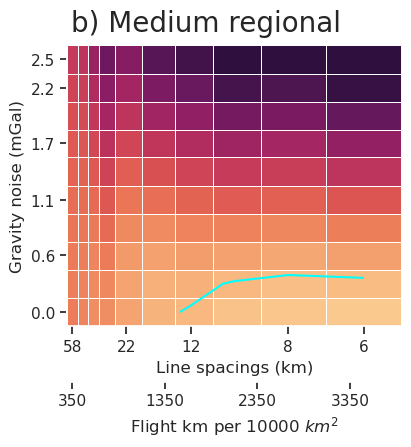

In [39]:
fig = RIS_plotting.plot_2var_ensemble(
    sampled_params_df_medium_regional,
    figsize=figsize,
    # x="grav_line_spacing",
    # x_title="Line spacing (km)",
    x="flight_kms_per_10000sq_km",
    x_title="Flight km per 10000 $km^2$",
    y="grav_noise_levels",
    y_title="Gravity noise (mGal)",
    background="inversion_mae",
    background_title="Bathymetry MAE (m)",
    background_robust=True,
    plot_contours=contours,
    contour_color="cyan",
    background_cpt_lims=cpt_lims,
    # flipx=True,
    # logx=True,
    colorbar=False,
)
bbox = dict(facecolor="lightgray", boxstyle="round")
# plt.gcf().text(0.1, 0.9, "b)", fontsize=16, va="bottom", ha="right")
# plt.gcf().text(0.5, 1.01, f"Medium regional ({round(sampled_params_df_medium_regional.regional_stdev.unique()[0])} mGal stdev)", fontsize=20, va="bottom", ha="center")
plt.gcf().text(0.5, 1.01, "b) Medium regional", fontsize=20, va="bottom", ha="center")

ax = fig.get_axes()[0]

# specify x ticks
ax.grid(True)
vals = sampled_params_df_medium_regional.flight_kms_per_10000sq_km.unique()
vals_original = [vals[0], vals[4], vals[6], vals[8], vals[-1]]
vals = np.arange(vals[0], vals[-1], 1000)
ax.set_xticks(vals)
ax.set_xticklabels([round(x) for x in vals])
ax.spines["bottom"].set_position(("outward", 40))

# add second x axis for line spacing
ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
new_vals = sampled_params_df_medium_regional.grav_line_spacing.unique()
new_vals = [new_vals[0], new_vals[4], new_vals[6], new_vals[8], new_vals[-1]]
labels = [round(x) for x in new_vals]
ax2.set_xticks(vals_original)
ax2.set_xticklabels(labels)
ax2.grid(False)
ax2.set_xlabel("Line spacings (km)")
ax2.xaxis.set_ticks_position("bottom")
ax2.xaxis.set_label_position("bottom")

# specify y ticks
yvals = list(sampled_params_df_medium_regional.grav_noise_levels.unique())[::2]
yvals.append(sampled_params_df_medium_regional.grav_noise_levels.unique()[-1])
ax.set_yticks(yvals)
ax.set_yticklabels([round(x, 1) for x in yvals])
ax.tick_params(
    axis="both",
    which="both",
    length=5,
    bottom=True,
    left=True,
)
plt.minorticks_off()

fig.savefig(
    "../../paper/figures/Ross_Sea_noise_vs_spacing_medium_regional_2var.png",
    bbox_inches="tight",
)

In [44]:
# ax2 = ax.twiny()
# ax2.set_xticks([vals[0], vals[4], vals[6], vals[8], vals[9]])

# vals = [int(x) for x in sampled_params_df_low_regional.grav_line_spacing.unique()]
# ax2.set_xticklabels([vals[0], vals[4], vals[6], vals[8], vals[9]])
# ax2.xaxis.set_ticks_position("bottom")
# ax2.xaxis.set_label_position("bottom")
# ax2.spines["bottom"].set_position(("outward", 40))
# ax2.set_xlim(ax.get_xlim())
# ax2.grid(False)
# ax2.set_xlabel("Line spacing (km)")

# fig.savefig("../../paper/figures/Ross_Sea_noise_vs_spacing_medium_regional_2var.png", bbox_inches="tight")
# fig

In [45]:
# plt.savefig("../../paper/figures/Ross_Sea_noise_vs_spacing_medium_regional_2var.png", bbox_inches="tight")

In [46]:
# fig = RIS_plotting.plot_2var_ensemble(
#     sampled_params_df_medium_regional,
#     figsize = (6,4),
#     x="grav_line_spacing",
#     y="grav_noise_levels",
#     x_title="Line spacing (km)",
#     y_title="Gravity noise (mGal)",

#     background="topo_improvement_mae",
#     background_title="Topo improvement (m)",

#     background_robust=True,
#     background_cmap="cmo.matter_r",
#     plot_contours=[0],
#     contour_color="cyan",
# )
# bbox = dict(facecolor='lightgray', boxstyle="round")
# plt.gcf().text(0.3, -.05, "many lines", fontsize=12, va="center", ha="right", bbox=bbox)
# plt.gcf().text(0.6, -.05, "few lines", fontsize=12, va="center", ha="left", bbox=bbox)

# plt.savefig('../../paper/figures/ensemble_4_medium_regional_2var.png')

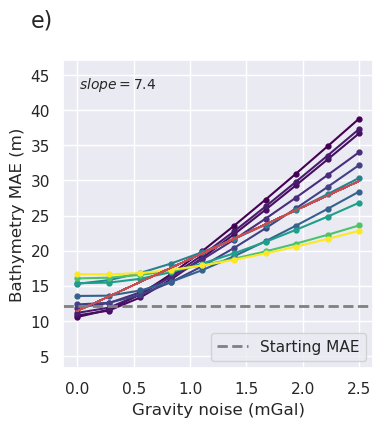

In [40]:
RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df_medium_regional,
    figsize=figsize,
    x="grav_noise_levels",
    x_label="Gravity noise (mGal)",
    y="inversion_mae",
    y_label="Bathymetry MAE (m)",
    groupby_col="grav_line_spacing",
    cbar_label="Line spacing (km)",
    # groupby_col="flight_kms_per_10000sq_km",
    # cbar_label="Flight km per 10000 $km^2$",
    trend_line=True,
    horizontal_line=starting_bathymetry_mae,
    horizontal_line_label="Starting MAE",
    horizontal_line_label_loc="lower right",
    y_lims=line_plot_ylims,
    colorbar=False,
)
plt.gcf().text(0.1, 0.95, "e)", fontsize=16, va="bottom", ha="right")
plt.savefig(
    "../../paper/figures/Ross_Sea_noise_vs_spacing_medium_regional_bathy_error_vs_grav_noise.png",
    bbox_inches="tight",
)

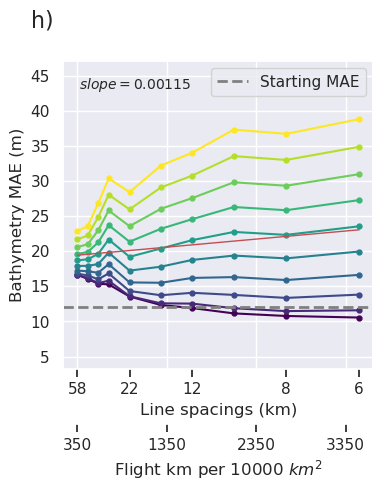

In [41]:
fig = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df_medium_regional,
    figsize=figsize,
    # x="grav_line_spacing",
    # x_label="Line spacing (km)",
    x="flight_kms_per_10000sq_km",
    x_label="Flight km per 10000 $km^2$",
    y="inversion_mae",
    y_label="Bathymetry MAE (m)",
    groupby_col="grav_noise_levels",
    cbar_label="Gravity noise (mGal)",
    trend_line=True,
    horizontal_line=starting_bathymetry_mae,
    horizontal_line_label="Starting MAE",
    horizontal_line_label_loc="upper right",
    y_lims=line_plot_ylims,
    # flipx=True,
    colorbar=False,
)
plt.gcf().text(0.1, 0.95, "h)", fontsize=16, va="bottom", ha="right")

ax = fig.get_axes()[0]

# specify x ticks
ax.grid(True)
vals = sampled_params_df_medium_regional.flight_kms_per_10000sq_km.unique()
vals_original = [vals[0], vals[4], vals[6], vals[8], vals[-1]]
vals = np.arange(vals[0], vals[-1], 1000)
ax.set_xticks(vals)
ax.set_xticklabels([round(x) for x in vals])
ax.spines["bottom"].set_position(("outward", 40))

# add second x axis for line spacing
ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
new_vals = sampled_params_df_medium_regional.grav_line_spacing.unique()
new_vals = [new_vals[0], new_vals[4], new_vals[6], new_vals[8], new_vals[-1]]
labels = [round(x) for x in new_vals]
ax2.set_xticks(vals_original)
ax2.set_xticklabels(labels)
ax2.grid(False)
ax2.set_xlabel("Line spacings (km)")
ax2.xaxis.set_ticks_position("bottom")
ax2.xaxis.set_label_position("bottom")

plt.savefig(
    "../../paper/figures/Ross_Sea_noise_vs_spacing_medium_regional_bathy_error_vs_grav_spacing.png",
    bbox_inches="tight",
)

In [49]:
# # subplots showing inverted bathymetry's
# grids = []
# cbar_labels = []
# row_titles = []
# column_titles = []

# # iterate over the ensemble starting with high noise, low line numbers
# # row per noise level and column per line spacing
# for i, row in sampled_params_df_medium_regional.sort_values(by=["grav_noise_levels", "grav_line_spacing"], ascending=False,).iterrows():
#     inverted_bathymetry = xr.open_dataarray(row.inverted_bathymetry_fname)
#     reg = vd.pad_region(inversion_region, -3*spacing)
#     # reg = inversion_region
#     inverted_bathymetry = inverted_bathymetry.sel(
#         easting=slice(reg[0], reg[1]),
#         northing=slice(reg[2], reg[3]),
#     )
#     # add to lists
#     grids.append(inverted_bathymetry)
#     cbar_labels.append(f"MAE: {round(row.inversion_mae,2)} (m)")
#     if i % np.sqrt(len(sampled_params_df_medium_regional)) == 0:
#         column_titles.append(f"Spacing: {round(row.grav_line_spacing)} km")
#     if i < np.sqrt(len(sampled_params_df_medium_regional)):
#         row_titles.append(f"Noise: {round(row.grav_noise_levels,1)} mGal")

# fig = maps.subplots(
#     grids,
#     fig_height=8,
#     fig_title="Inverted bathymetry",
#     fig_title_font="75p,Helvetica-Bold,black",
#     fig_title_y_offset="5c",
#     cbar_labels=cbar_labels,
#     cmap="rain",
#     reverse_cpt=True,
#     # colorbar=False,
#     # hist=True,
#     cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
#     cbar_font="18p,Helvetica,black",
#     row_titles=row_titles,
#     column_titles=column_titles,
#     row_titles_font="25p,Helvetica,black",
#     column_titles_font="25p,Helvetica,black",
# )
# fig.show()

In [42]:
# subplots showing inverted bathymetry's
grids = []
cbar_labels = []
row_titles = []
column_titles = []

df = sampled_params_df_medium_regional
# iterate over the ensemble starting with high noise, small line spacing
# row per noise level and column per line spacing
for i, row in df.sort_values(
    by=["grav_noise_levels", "grav_line_spacing"], ascending=[False, True]
).iterrows():
    inverted_bathymetry = xr.open_dataarray(row.inverted_bathymetry_fname)

    dif = bathymetry - inverted_bathymetry

    # reg = vd.pad_region(inversion_region, -3*spacing)
    reg = inversion_region
    inverted_bathymetry = inverted_bathymetry.sel(
        easting=slice(reg[0], reg[1]),
        northing=slice(reg[2], reg[3]),
    )
    dif = dif.sel(
        easting=slice(reg[0], reg[1]),
        northing=slice(reg[2], reg[3]),
    )
    # add to lists
    grids.append(inverted_bathymetry)
    grids.append(dif)
    cbar_labels.append(f"MAE: {round(row.inversion_mae,2)} m")
    cbar_labels.append(" ")
    if i % np.sqrt(len(df)) == 0:
        column_titles.append(round(row.grav_line_spacing))
        column_titles.append(" ")
    if i < np.sqrt(len(df)):
        row_titles.append(round(row.grav_noise_levels, 1))
        # row_titles.append(" ")

fig = maps.subplots(
    grids,
    dims=(np.sqrt(len(df)), 2 * np.sqrt(len(df))),
    fig_height=8,
    fig_title="Medium regional",
    fig_x_axis_title="Flight line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    fig_x_axis_title_y_offset="2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmaps=[x for xs in [["rain", "balance+h0"] for x in range(len(df))] for x in xs],
    reverse_cpt=True,
    # colorbar=False,
    # hist=True,
    # cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cpt_limits=[
        x
        for xs in [
            [
                polar_utils.get_combined_min_max(grids[::2], robust=True),
                polar_utils.get_combined_min_max(grids[1::2], robust=True),
            ]
            for x in range(len(df))
        ]
        for x in xs
    ],
    cbar_font="45p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    row_titles_font="70p,Helvetica,black",
    column_titles_font="70p,Helvetica,black",
)

fig.savefig(
    "../../paper/figures/Ross_Sea_ensemble_medium_regional_inverted_bathymetry_and_errors.png",
    dpi=500,
)
fig.show()

In [51]:
# for i, row in sampled_params_df_medium_regional.iterrows():
#     grav_df = pd.read_csv(row.grav_df_fname)
#     # true_reg = grav_df.gravity_anomaly - grav_df.bathymetry_grav
#     # true_reg = grav_df.misfit - grav_df.true_res
#     true_reg = grav_df.basement_grav
#     # true_reg = grav_df.misfit - grav_df.res


#     sampled_params_df_medium_regional.loc[i, "misfit_stdev"] = grav_df.misfit.std()
#     sampled_params_df_medium_regional.loc[i, "grav_anom_stdev"] = grav_df.gravity_anomaly.std()
#     sampled_params_df_medium_regional.loc[i, "true_regional_stdev"] = true_reg.std()
#     sampled_params_df_medium_regional.loc[i, "estimated_regional_stdev"] = grav_df.reg.std()

# sampled_params_df_medium_regional.head()

In [52]:
# sampled_params_df_medium_regional["regional_strength_estimation"]=sampled_params_df_medium_regional.true_regional_stdev-sampled_params_df_medium_regional.estimated_regional_stdev

# fig = RIS_plotting.plot_2var_ensemble(
#     sampled_params_df_medium_regional,
#     figsize=figsize,
#     # x="grav_line_spacing",
#     # x_title="Line spacing (km)",
#     x="flight_kms_per_10000sq_km",
#     x_title="Flight km per 10000 $km^2$",
#     y="grav_noise_levels",
#     y_title="Gravity noise (mGal)",
#     background="regional_strength_estimation",
#     background_title="regional_strength_estimation",
#     background_robust=True,
#     background_cmap="cmo.balance",
#     plot_contours=contours,
#     contour_color="cyan",
#     # background_cpt_lims=cpt_lims,
#     # flipx=True,
# )

## Strong regional

In [43]:
sampled_params_df_strong_regional["regional_stdev"] = np.nan
for i, row in sampled_params_df_strong_regional.iterrows():
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)
    sampled_params_df_strong_regional.loc[i, "regional_stdev"] = float(
        grav_df.basement_grav.std()
    )

sampled_params_df_strong_regional.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_data_loss_rmse,grav_data_loss_mae,damping_cv_results_fname,best_damping,constraints_damping_cv_rmse,inversion_rmse,inversion_mae,inverted_bathymetry_fname,topo_improvement_rmse,topo_improvement_mae,flight_kms,flight_kms_per_10000sq_km,regional_stdev
0,3,0.00,../../results/Ross_Sea_09_grav_spacing_vs_nois...,../../results/Ross_Sea_09_grav_spacing_vs_nois...,58.333333,7.401497,4.192133,../../results/Ross_Sea_09_grav_spacing_vs_nois...,0.025,1.525870,32.003342,21.751075,../../results/Ross_Sea_09_grav_spacing_vs_nois...,-9.985942,-7.973938,1050.0,350.0,20.457927
1,3,0.28,../../results/Ross_Sea_09_grav_spacing_vs_nois...,../../results/Ross_Sea_09_grav_spacing_vs_nois...,58.333333,7.417798,4.221658,../../results/Ross_Sea_09_grav_spacing_vs_nois...,0.025,1.531843,31.945917,21.735264,../../results/Ross_Sea_09_grav_spacing_vs_nois...,-9.928516,-7.958128,1050.0,350.0,20.457927
2,3,0.56,../../results/Ross_Sea_09_grav_spacing_vs_nois...,../../results/Ross_Sea_09_grav_spacing_vs_nois...,58.333333,7.438244,4.270387,../../results/Ross_Sea_09_grav_spacing_vs_nois...,0.025,1.566146,32.092664,21.947453,../../results/Ross_Sea_09_grav_spacing_vs_nois...,-10.075263,-8.170317,1050.0,350.0,20.457927
3,3,0.83,../../results/Ross_Sea_09_grav_spacing_vs_nois...,../../results/Ross_Sea_09_grav_spacing_vs_nois...,58.333333,7.461856,4.328971,../../results/Ross_Sea_09_grav_spacing_vs_nois...,0.025,1.624443,32.427132,22.322378,../../results/Ross_Sea_09_grav_spacing_vs_nois...,-10.409732,-8.545241,1050.0,350.0,20.457927
4,3,1.11,../../results/Ross_Sea_09_grav_spacing_vs_nois...,../../results/Ross_Sea_09_grav_spacing_vs_nois...,58.333333,7.490342,4.397305,../../results/Ross_Sea_09_grav_spacing_vs_nois...,0.025,1.708412,32.974565,22.876467,../../results/Ross_Sea_09_grav_spacing_vs_nois...,-10.957164,-9.099330,1050.0,350.0,20.457927


In [44]:
sampled_params_df_strong_regional.regional_stdev.unique()

array([20.45792721])

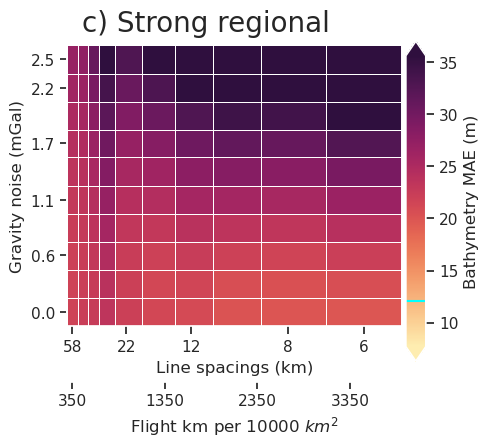

In [45]:
fig = RIS_plotting.plot_2var_ensemble(
    sampled_params_df_strong_regional,
    figsize=figsize,
    # x="grav_line_spacing",
    # x_title="Line spacing (km)",
    x="flight_kms_per_10000sq_km",
    x_title="Flight km per 10000 $km^2$",
    y="grav_noise_levels",
    y_title="Gravity noise (mGal)",
    background="inversion_mae",
    background_title="Bathymetry MAE (m)",
    background_robust=True,
    plot_contours=contours,
    contour_color="cyan",
    background_cpt_lims=cpt_lims,
    # flipx=True,
    # logx=True,
    # colorbar=False,
)
bbox = dict(facecolor="lightgray", boxstyle="round")
# plt.gcf().text(0.1, 0.9, "c)", fontsize=16, va="bottom", ha="right")
# plt.gcf().text(0.5, 1.01, f"Strong regional ({round(sampled_params_df_strong_regional.regional_stdev.unique()[0])} mGal stdev)", fontsize=20, va="bottom", ha="center")
plt.gcf().text(0.5, 1.01, "c) Strong regional", fontsize=20, va="bottom", ha="center")

ax = fig.get_axes()[0]

# specify x ticks
ax.grid(True)
vals = sampled_params_df_strong_regional.flight_kms_per_10000sq_km.unique()
vals_original = [vals[0], vals[4], vals[6], vals[8], vals[-1]]
vals = np.arange(vals[0], vals[-1], 1000)
ax.set_xticks(vals)
ax.set_xticklabels([round(x) for x in vals])
ax.spines["bottom"].set_position(("outward", 40))

# add second x axis for line spacing
ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
new_vals = sampled_params_df_strong_regional.grav_line_spacing.unique()
new_vals = [new_vals[0], new_vals[4], new_vals[6], new_vals[8], new_vals[-1]]
labels = [round(x) for x in new_vals]
ax2.set_xticks(vals_original)
ax2.set_xticklabels(labels)
ax2.grid(False)
ax2.set_xlabel("Line spacings (km)")
ax2.xaxis.set_ticks_position("bottom")
ax2.xaxis.set_label_position("bottom")

# specify y ticks
yvals = list(sampled_params_df_strong_regional.grav_noise_levels.unique())[::2]
yvals.append(sampled_params_df_strong_regional.grav_noise_levels.unique()[-1])
ax.set_yticks(yvals)
ax.set_yticklabels([round(x, 1) for x in yvals])
ax.tick_params(
    axis="both",
    which="both",
    length=5,
    bottom=True,
    left=True,
)

plt.minorticks_off()
fig.savefig(
    "../../paper/figures/Ross_Sea_noise_vs_spacing_strong_regional_2var.png",
    bbox_inches="tight",
)

In [46]:
# ax2 = ax.twiny()
# ax2.set_xticks([vals[0], vals[4], vals[6], vals[8], vals[9]])

# vals = [int(x) for x in sampled_params_df_low_regional.grav_line_spacing.unique()]
# ax2.set_xticklabels([vals[0], vals[4], vals[6], vals[8], vals[9]])
# ax2.xaxis.set_ticks_position("bottom")
# ax2.xaxis.set_label_position("bottom")
# ax2.spines["bottom"].set_position(("outward", 40))
# ax2.set_xlim(ax.get_xlim())
# ax2.grid(False)
# ax2.set_xlabel("Line spacing (km)")

# fig.savefig("../../paper/figures/Ross_Sea_noise_vs_spacing_strong_regional_2var.png", bbox_inches="tight")
# fig

In [47]:
# fig = RIS_plotting.plot_2var_ensemble(
#     sampled_params_df_strong_regional,
#     figsize = (6,4),
#     x="grav_line_spacing",
#     y="grav_noise_levels",
#     x_title="Line spacing (km)",
#     y_title="Gravity noise (mGal)",

#     background="topo_improvement_mae",
#     background_title="Topo improvement (m)",

#     background_robust=True,
#     background_cmap="cmo.matter_r",
#     plot_contours=[0],
#     contour_color="cyan",
# )
# bbox = dict(facecolor='lightgray', boxstyle="round")
# plt.gcf().text(0.3, -.05, "many lines", fontsize=12, va="center", ha="right", bbox=bbox)
# plt.gcf().text(0.6, -.05, "few lines", fontsize=12, va="center", ha="left", bbox=bbox)

# plt.savefig('../../paper/figures/ensemble_3_strong_regional_2var.png')

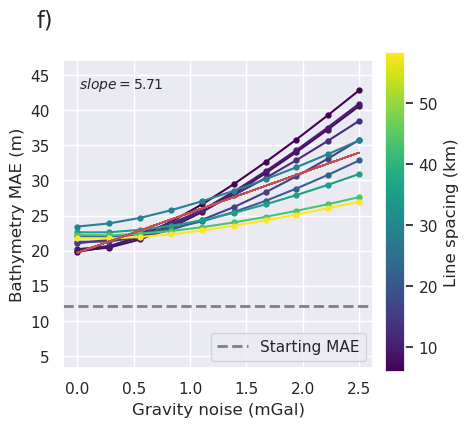

In [48]:
RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df_strong_regional,
    figsize=figsize,
    x="grav_noise_levels",
    x_label="Gravity noise (mGal)",
    y="inversion_mae",
    y_label="Bathymetry MAE (m)",
    groupby_col="grav_line_spacing",
    cbar_label="Line spacing (km)",
    # groupby_col="flight_kms_per_10000sq_km",
    # cbar_label="Flight km per 10000 $km^2$",
    trend_line=True,
    horizontal_line=starting_bathymetry_mae,
    horizontal_line_label="Starting MAE",
    horizontal_line_label_loc="lower right",
    y_lims=line_plot_ylims,
)
plt.gcf().text(0.1, 0.95, "f)", fontsize=16, va="bottom", ha="right")
plt.savefig(
    "../../paper/figures/Ross_Sea_noise_vs_spacing_strong_regional_bathy_error_vs_grav_noise.png",
    bbox_inches="tight",
)

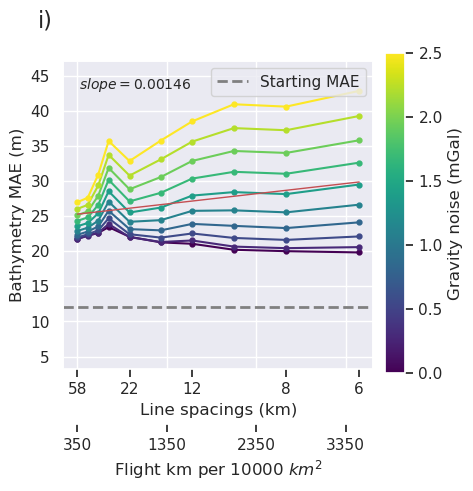

In [49]:
fig = RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df_strong_regional,
    figsize=figsize,
    # x="grav_line_spacing",
    # x_label="Line spacing (km)",
    x="flight_kms_per_10000sq_km",
    x_label="Flight km per 10000 $km^2$",
    y="inversion_mae",
    y_label="Bathymetry MAE (m)",
    groupby_col="grav_noise_levels",
    cbar_label="Gravity noise (mGal)",
    trend_line=True,
    horizontal_line=starting_bathymetry_mae,
    horizontal_line_label="Starting MAE",
    horizontal_line_label_loc="upper right",
    y_lims=line_plot_ylims,
)
plt.gcf().text(0.1, 0.95, "i)", fontsize=16, va="bottom", ha="right")

ax = fig.get_axes()[0]

# specify x ticks
ax.grid(True)
vals = sampled_params_df_strong_regional.flight_kms_per_10000sq_km.unique()
vals_original = [vals[0], vals[4], vals[6], vals[8], vals[-1]]
vals = np.arange(vals[0], vals[-1], 1000)
ax.set_xticks(vals)
ax.set_xticklabels([round(x) for x in vals])
ax.spines["bottom"].set_position(("outward", 40))

# add second x axis for line spacing
ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
new_vals = sampled_params_df_strong_regional.grav_line_spacing.unique()
new_vals = [new_vals[0], new_vals[4], new_vals[6], new_vals[8], new_vals[-1]]
labels = [round(x) for x in new_vals]
ax2.set_xticks(vals_original)
ax2.set_xticklabels(labels)
ax2.grid(False)
ax2.set_xlabel("Line spacings (km)")
ax2.xaxis.set_ticks_position("bottom")
ax2.xaxis.set_label_position("bottom")

plt.savefig(
    "../../paper/figures/Ross_Sea_noise_vs_spacing_strong_regional_bathy_error_vs_grav_spacing.png",
    bbox_inches="tight",
)

In [50]:
# subplots showing inverted bathymetry's
grids = []
cbar_labels = []
row_titles = []
column_titles = []

df = sampled_params_df_strong_regional
# iterate over the ensemble starting with high noise, small line spacing
# row per noise level and column per line spacing
for i, row in df.sort_values(
    by=["grav_noise_levels", "grav_line_spacing"], ascending=[False, True]
).iterrows():
    inverted_bathymetry = xr.open_dataarray(row.inverted_bathymetry_fname)

    dif = bathymetry - inverted_bathymetry

    # reg = vd.pad_region(inversion_region, -3*spacing)
    reg = inversion_region
    inverted_bathymetry = inverted_bathymetry.sel(
        easting=slice(reg[0], reg[1]),
        northing=slice(reg[2], reg[3]),
    )
    dif = dif.sel(
        easting=slice(reg[0], reg[1]),
        northing=slice(reg[2], reg[3]),
    )
    # add to lists
    grids.append(inverted_bathymetry)
    grids.append(dif)
    cbar_labels.append(f"MAE: {round(row.inversion_mae,2)} m")
    cbar_labels.append(" ")
    if i % np.sqrt(len(df)) == 0:
        column_titles.append(round(row.grav_line_spacing))
        column_titles.append(" ")
    if i < np.sqrt(len(df)):
        row_titles.append(round(row.grav_noise_levels, 1))
        # row_titles.append(" ")

fig = maps.subplots(
    grids,
    dims=(np.sqrt(len(df)), 2 * np.sqrt(len(df))),
    fig_height=8,
    fig_title="Strong regional",
    fig_x_axis_title="Flight line spacing (km)",
    fig_y_axis_title="Gravity noise (mGal)",
    fig_title_font="100p,Helvetica-Bold,black",
    fig_axis_title_font="80p,Helvetica-Bold,black",
    fig_title_y_offset="8c",
    fig_x_axis_title_y_offset="2.5c",
    fig_y_axis_title_x_offset="3c",
    cbar_labels=cbar_labels,
    cmaps=[x for xs in [["rain", "balance+h0"] for x in range(len(df))] for x in xs],
    reverse_cpt=True,
    # colorbar=False,
    # hist=True,
    # cpt_lims=polar_utils.get_combined_min_max(grids, robust=True),
    cpt_limits=[
        x
        for xs in [
            [
                polar_utils.get_combined_min_max(grids[::2], robust=True),
                polar_utils.get_combined_min_max(grids[1::2], robust=True),
            ]
            for x in range(len(df))
        ]
        for x in xs
    ],
    cbar_font="45p,Helvetica,black",
    row_titles=row_titles,
    column_titles=column_titles,
    row_titles_font="70p,Helvetica,black",
    column_titles_font="70p,Helvetica,black",
)

fig.savefig(
    "../../paper/figures/Ross_Sea_ensemble_strong_regional_inverted_bathymetry_and_errors.png",
    dpi=500,
)
fig.show()

In [62]:
# for i, row in sampled_params_df_strong_regional.iterrows():
#     grav_df = pd.read_csv(row.grav_df_fname)
#     # true_reg = grav_df.gravity_anomaly - grav_df.bathymetry_grav
#     true_reg = grav_df.basement_grav

#     sampled_params_df_strong_regional.loc[i, "misfit_stdev"] = grav_df.misfit.std()
#     sampled_params_df_strong_regional.loc[i, "grav_anom_stdev"] = grav_df.gravity_anomaly.std()
#     sampled_params_df_strong_regional.loc[i, "true_regional_stdev"] = true_reg.std()
#     sampled_params_df_strong_regional.loc[i, "estimated_regional_stdev"] = grav_df.reg.std()

# sampled_params_df_strong_regional.head()

In [63]:
# sampled_params_df_strong_regional["true_regional_stdev"]

In [64]:
# anoms = [
#     "misfit_stdev",
#     "grav_anom_stdev",
#     "estimated_regional_stdev",
# ]
# reg_stats = [
#     "true_regional_stdev",
# ]
# df = sampled_params_df_strong_regional[anoms+reg_stats].corr()[reg_stats].drop(reg_stats)
# sns.heatmap(
#     df,
#     # robust=True,
#     annot=True,
#     vmin=0.5,
#     vmax=0.98,
# )
# plt.title("Grav spacings vs noise; Strong regional", fontsize=15)
# df

In [65]:
# anoms = [
#     "misfit_stdev",

#     "grav_anom_stdev",

#     "estimated_regional_stdev",
# ]
# reg_stats = [
#     "true_regional_stdev",
# ]
# df = sampled_params_df_strong_regional[anoms+reg_stats].corr()[reg_stats].drop(reg_stats)
# sns.heatmap(
#     df,
#     # robust=True,
#     annot=True,
#     vmin=0.5,
#     vmax=0.98,
# )
# plt.title("Grav spacings vs noise; Strong regional", fontsize=15)
# df

In [66]:
# sampled_params_df_strong_regional["regional_strength_estimation"]=sampled_params_df_strong_regional.true_regional_stdev-sampled_params_df_strong_regional.grav_anom_stdev

# fig = RIS_plotting.plot_2var_ensemble(
#     sampled_params_df_strong_regional,
#     figsize=figsize,
#     # x="grav_line_spacing",
#     # x_title="Line spacing (km)",
#     x="flight_kms_per_10000sq_km",
#     x_title="Flight km per 10000 $km^2$",
#     y="grav_noise_levels",
#     y_title="Gravity noise (mGal)",
#     background="regional_strength_estimation",
#     background_title="regional_strength_estimation",
#     background_robust=True,
#     background_cmap="cmo.balance",
#     background_cpt_lims=[-1,1],
#     plot_contours=contours,
#     contour_color="cyan",
#     # background_cpt_lims=cpt_lims,
#     # flipx=True,
# )

# 5 m of inversion improvement

In [67]:
# width = (inversion_region[1] - inversion_region[0]) / 1e3
# height = (inversion_region[3] - inversion_region[2]) / 1e3
# width, height

In [68]:
# inversion_area

In [69]:
# line_spacing = 85
# width / line_spacing, height / line_spacing

In [70]:
# grav_survey_85k = RIS_synth.airborne_survey(
#     along_line_spacing=1e3,
#     grav_observation_height=1e3,
#     NS_line_spacing=85e3,
#     EW_line_spacing=85e3,
#     region=inversion_region,
#     plot=True,
# )

In [71]:
# 85 - 35

In [72]:
# grav_survey_50k = RIS_synth.airborne_survey(
#     along_line_spacing=1e3,
#     grav_observation_height=1e3,
#     NS_line_spacing=50e3,
#     EW_line_spacing=50e3,
#     region=inversion_region,
#     plot=True,
# )

In [73]:
# # semi-regularly spaced
# constraints_80k = RIS_synth.constraint_layout_number(
#     spacing=(80e3, 80e3), region=inversion_region, plot=True
# )

In [74]:
# # semi-regularly spaced
# constraints_73k = RIS_synth.constraint_layout_number(
#     spacing=(73e3, 73e3), region=inversion_region, plot=True
# )

In [75]:
# len(grav_survey_85k)

In [76]:
# len(grav_survey_50k)

In [77]:
# fig = maps.basemap(
#     region=inversion_region,
#     # frame=True,
#     fig_height=10,
#     scalebar=True,
#     scale_position="JBC+o0c/.1c",
# )

# fig.plot(
#     grav_survey_85k[["easting", "northing"]],
#     style="p.1c",
#     fill="purple",
#     label=f"85 km spacing; {len(grav_survey_85k)} line-kms",
# )
# fig.plot(
#     grav_survey_50k[["easting", "northing"]],
#     style="p.1c",
#     fill="orange",
#     label=f"50 km spacing; {len(grav_survey_50k)} line-kms",
# )

# fig.legend()
# fig.show()

In [78]:
# fig = maps.basemap(
#     region=inversion_region,
#     # frame=True,
#     fig_height=10,
#     scalebar=True,
#     scale_position="JBC+o0c/.1c",
# )

# fig.plot(
#     constraints_80k[["easting", "northing"]],
#     style="t.3c",
#     fill="purple",
#     pen="1p,black",
#     label=f"80 km spacing; {len(constraints_80k)} points",
# )
# fig.plot(
#     constraints_73k[["easting", "northing"]],
#     style="t.3c",
#     fill="orange",
#     pen="1p,black",
#     label=f"73 km spacing; {len(constraints_73k)} points",
# )

# fig.legend()
# fig.show()